<a href="https://colab.research.google.com/github/EhsanulHaque75/ResearchCode/blob/main/machine_fault_best.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
df=pd.read_excel('All Data (1).xlsx')

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40040 entries, 0 to 40039
Data columns (total 11 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Unnamed: 0                       0 non-null      float64
 1   Tn (Rated Torque) N*m            40040 non-null  float64
 2   k (constant of proportionality)  40040 non-null  float64
 3   time (sec)                       40040 non-null  float64
 4   Ia (Amp)                         40040 non-null  float64
 5   Ib (Amp)                         40040 non-null  float64
 6   Ic (Amp)                         40037 non-null  float64
 7   Vab (V)                          40040 non-null  float64
 8   Torque (N*m)                     40040 non-null  float64
 9   Speed (rad/s)                    40040 non-null  float64
 10  Category                         40040 non-null  object 
dtypes: float64(10), object(1)
memory usage: 3.4+ MB


In [ ]:
category_counts = df['Category'].value_counts()

print(category_counts)

Category
NOM     13013
PTPF     7007
PTGF     7007
OVF      5005
OLF      5005
UVF      3003
Name: count, dtype: int64


In [ ]:
df = df.drop(columns=['Unnamed: 0'], errors='ignore')


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40040 entries, 0 to 40039
Data columns (total 10 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Tn (Rated Torque) N*m            40040 non-null  float64
 1   k (constant of proportionality)  40040 non-null  float64
 2   time (sec)                       40040 non-null  float64
 3   Ia (Amp)                         40040 non-null  float64
 4   Ib (Amp)                         40040 non-null  float64
 5   Ic (Amp)                         40037 non-null  float64
 6   Vab (V)                          40040 non-null  float64
 7   Torque (N*m)                     40040 non-null  float64
 8   Speed (rad/s)                    40040 non-null  float64
 9   Category                         40040 non-null  object 
dtypes: float64(9), object(1)
memory usage: 3.1+ MB


In [ ]:
import pandas as pd


numeric_df = df.select_dtypes(include=['number'])

min_values = numeric_df.min()
max_values = numeric_df.max()
range_values = max_values - min_values


print("Minimum values:\n", min_values)
print("\nMaximum values:\n", max_values)
print("\nRange values:\n", range_values)


Minimum values:
 Tn (Rated Torque) N*m                0.800000
k (constant of proportionality)      0.000948
time (sec)                           0.000000
Ia (Amp)                             0.000000
Ib (Amp)                             0.000000
Ic (Amp)                             0.000000
Vab (V)                              0.000000
Torque (N*m)                      -404.837797
Speed (rad/s)                     -112.258007
dtype: float64

Maximum values:
 Tn (Rated Torque) N*m                2.500000
k (constant of proportionality)      0.002964
time (sec)                           0.500000
Ia (Amp)                            78.639350
Ib (Amp)                            79.113988
Ic (Amp)                            78.738940
Vab (V)                            649.516523
Torque (N*m)                       625.165923
Speed (rad/s)                      182.599449
dtype: float64

Range values:
 Tn (Rated Torque) N*m                 1.700000
k (constant of proportionality)       0.0020

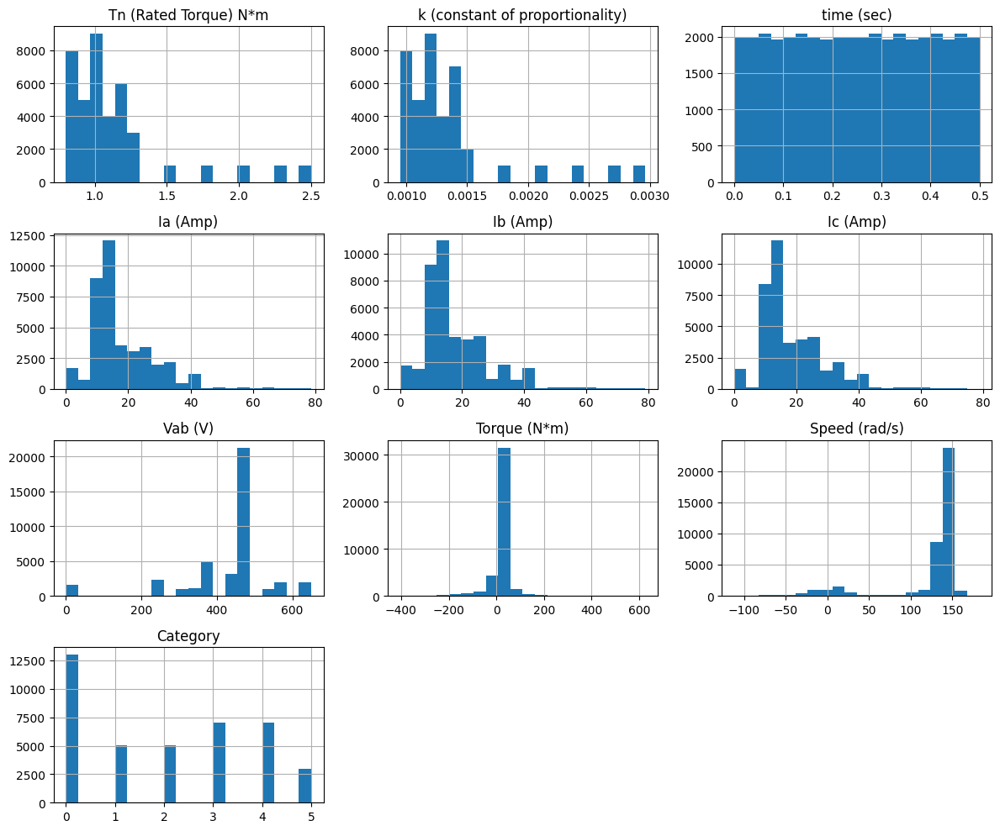

In [ ]:
# Distribution of numerical features
df.hist(figsize=(12, 10), bins=20)
plt.tight_layout()
plt.show()


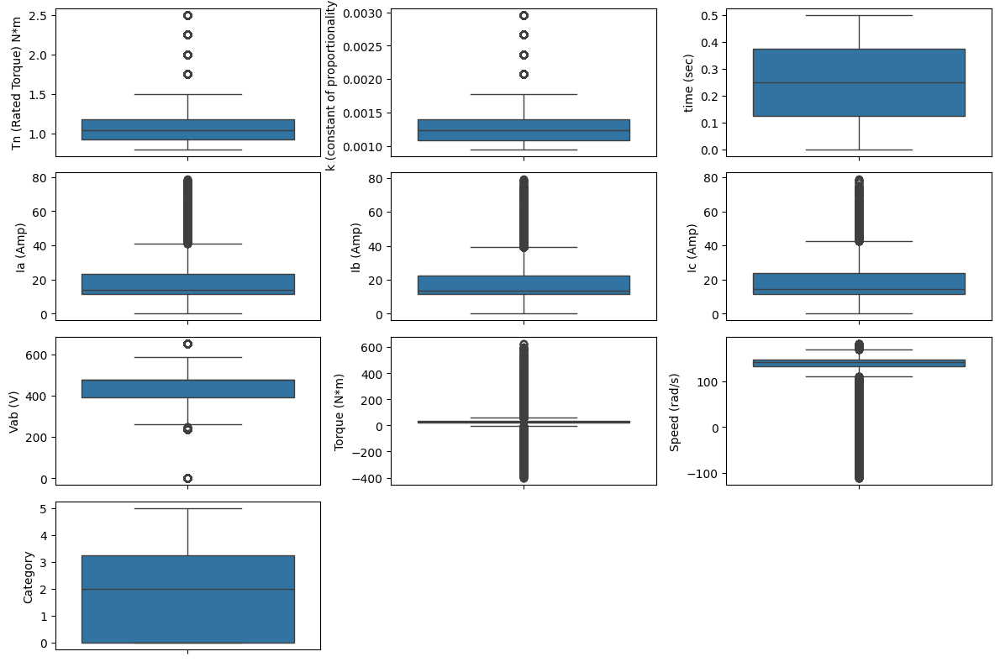

In [ ]:

n_cols = len(df.columns)


n_rows = (n_cols // 3) + (n_cols % 3 > 0)
n_cols_grid = 3

plt.figure(figsize=(12, 8))
for i, column in enumerate(df.columns, 1):
    plt.subplot(n_rows, n_cols_grid, i)
    sns.boxplot(df[column])
plt.tight_layout()
plt.show()


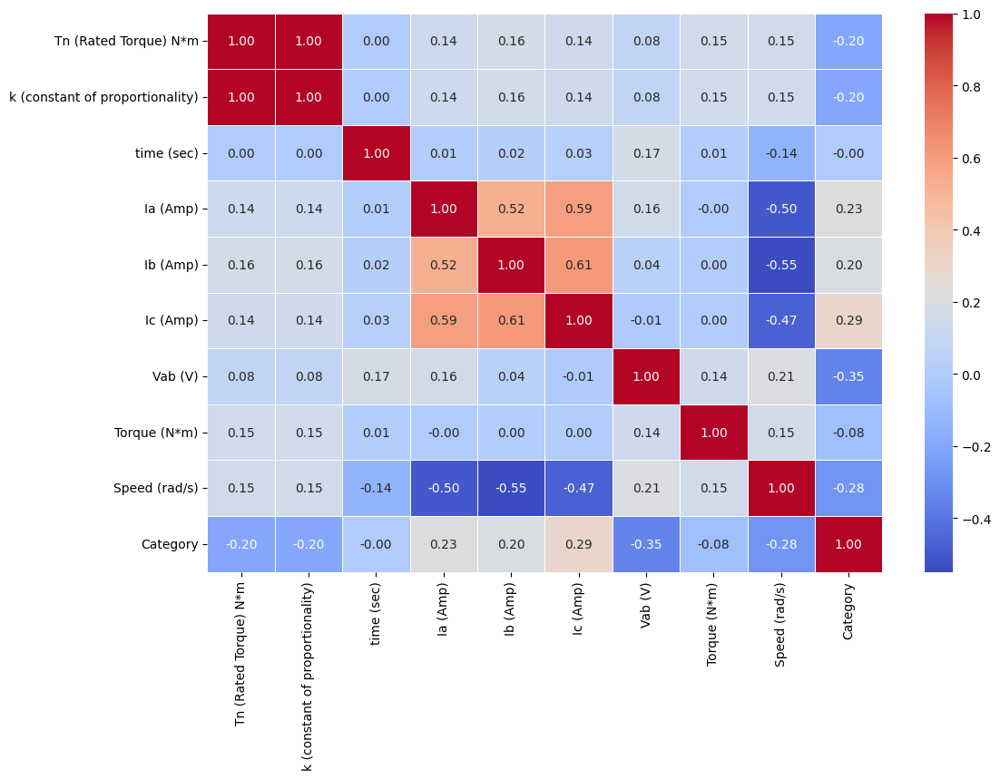

In [ ]:
# Correlation matrix to see relationships between features
plt.figure(figsize=(12, 8))
sns.heatmap(df.corr(), annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.show()


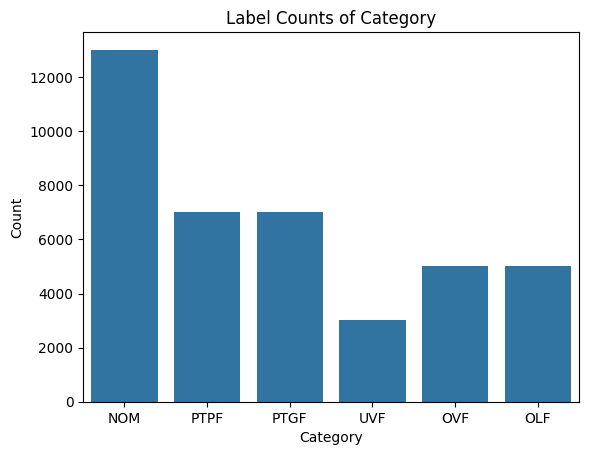

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt


sns.countplot(x='Category', data=df)
plt.title('Label Counts of Category')
plt.xlabel('Category')
plt.ylabel('Count')
plt.show()


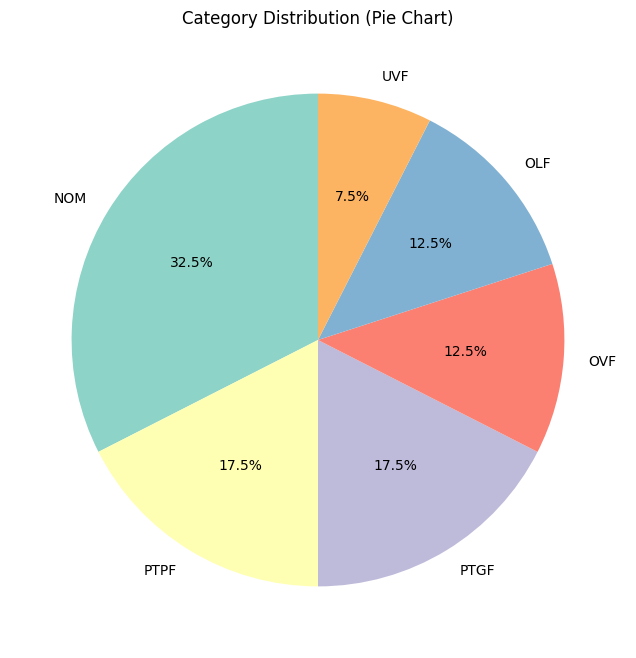

In [ ]:

category_counts = df['Category'].value_counts()


plt.figure(figsize=(8, 8))
category_counts.plot(kind='pie', autopct='%1.1f%%', startangle=90, colors=sns.color_palette("Set3", len(category_counts)))
plt.title('Category Distribution (Pie Chart)')
plt.ylabel('')
plt.show()

ValueError: num must be an integer with 1 <= num <= 9, not 10

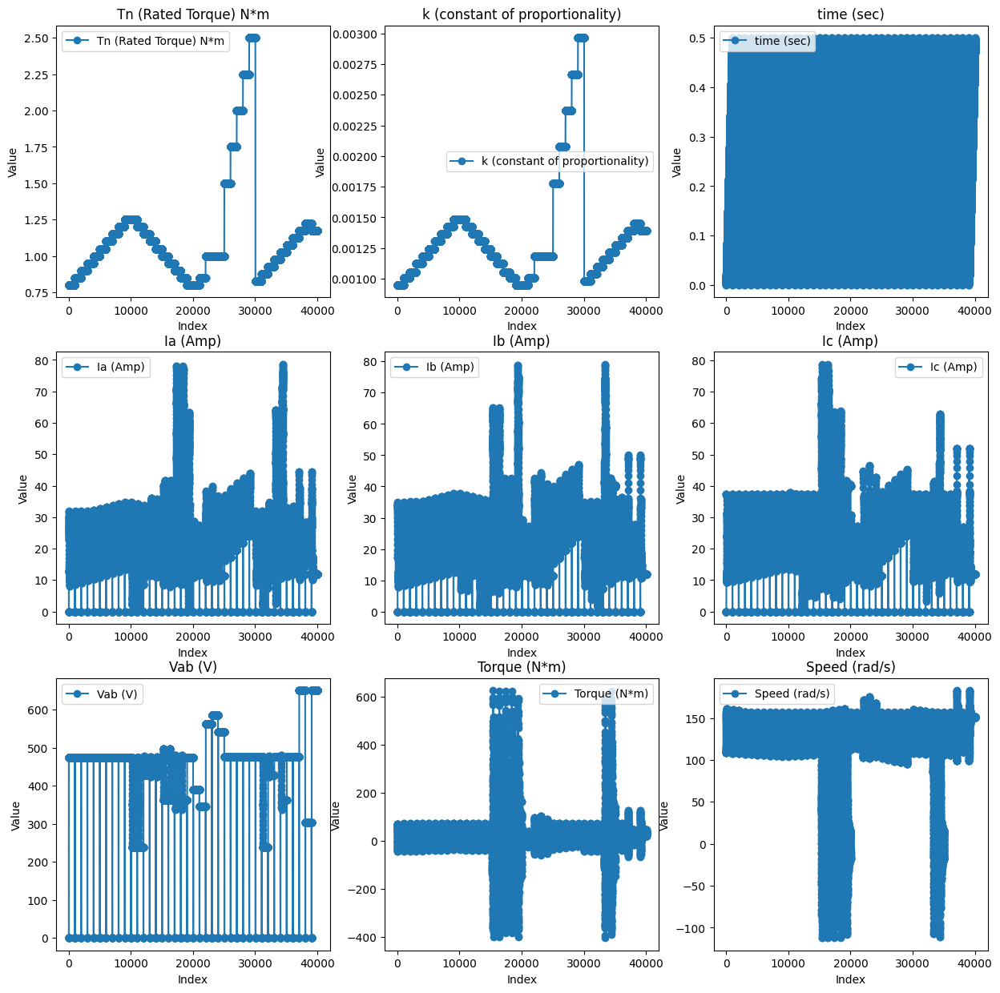

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(15, 15))

for i, column in enumerate(df.columns, 1):
    plt.subplot(3, 3, i)
    plt.plot(df[column], label=column, linestyle='-', marker='o')
    plt.title(column)
    plt.xlabel('Index')
    plt.ylabel('Value')
    plt.legend(loc='best')

plt.tight_layout()
plt.show()

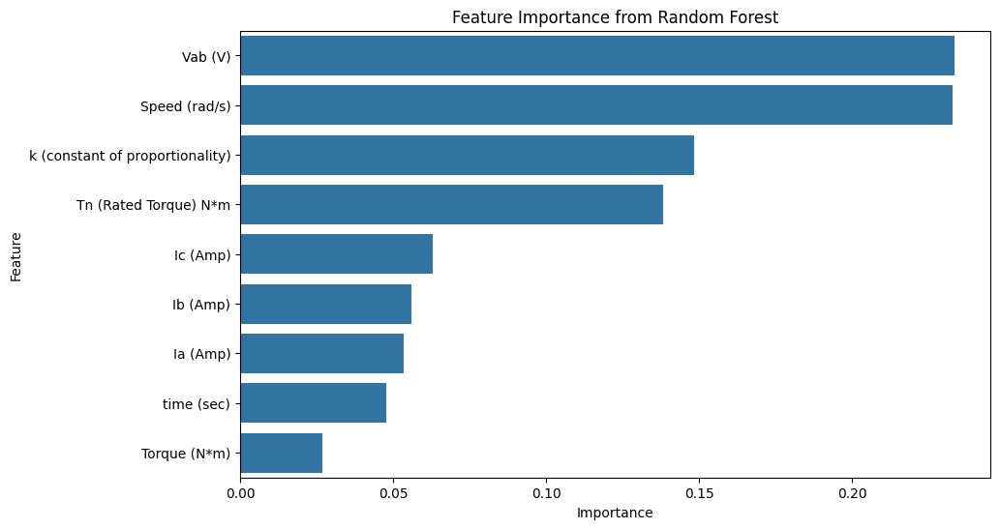

In [ ]:
from sklearn.ensemble import RandomForestClassifier
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming 'Category' is your target column and all other columns are features
X = df.drop('Category', axis=1)  # Features (exclude the target column)
y = df['Category']  # Target (Category column)

# Train a Random Forest Classifier
rf = RandomForestClassifier(n_estimators=100, random_state=42)
rf.fit(X, y)

# Get feature importances
feature_importances = rf.feature_importances_

# Create a DataFrame for better visualization
feature_importance_df = pd.DataFrame({
    'Feature': X.columns,
    'Importance': feature_importances
})

# Sort the DataFrame by importance
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

# Plotting the feature importance
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=feature_importance_df)
plt.title('Feature Importance from Random Forest')
plt.show()


In [ ]:
import pandas as pd

# Assuming df is your DataFrame
numeric_df = df.select_dtypes(include=['number'])  # Select only numeric columns

min_values = numeric_df.min()  # Minimum value of each numeric column
max_values = numeric_df.max()  # Maximum value of each numeric column
range_values = max_values - min_values  # Range for each numeric column
avg_values = numeric_df.mean()  # Average (mean) value of each numeric column

# Display the results
print("Minimum values:\n", min_values)
print("\nMaximum values:\n", max_values)
print("\nRange values:\n", range_values)
print("\nAverage values:\n", avg_values)


Minimum values:
 Tn (Rated Torque) N*m                0.800000
k (constant of proportionality)      0.000948
time (sec)                           0.000000
Ia (Amp)                             0.000000
Ib (Amp)                             0.000000
Ic (Amp)                             0.000000
Vab (V)                              0.000000
Torque (N*m)                      -404.837797
Speed (rad/s)                     -112.258007
Category                             0.000000
dtype: float64

Maximum values:
 Tn (Rated Torque) N*m                2.500000
k (constant of proportionality)      0.002964
time (sec)                           0.500000
Ia (Amp)                            78.639350
Ib (Amp)                            79.113988
Ic (Amp)                            78.738940
Vab (V)                            649.516523
Torque (N*m)                       625.165923
Speed (rad/s)                      182.599449
Category                             5.000000
dtype: float64

Range values:


In [ ]:
# Skewness and Kurtosis
skewness = df.skew()
kurtosis = df.kurt()
print("Skewness:\n", skewness)
print("Kurtosis:\n", kurtosis)


Skewness:
 Tn (Rated Torque) N*m              2.191088
k (constant of proportionality)    2.186402
time (sec)                         0.000000
Ia (Amp)                           1.654887
Ib (Amp)                           1.505474
Ic (Amp)                           1.453311
Vab (V)                           -1.637558
Torque (N*m)                       0.790280
Speed (rad/s)                     -2.315635
Category                           0.214073
dtype: float64
Kurtosis:
 Tn (Rated Torque) N*m               4.531404
k (constant of proportionality)     4.514090
time (sec)                         -1.200002
Ia (Amp)                            4.711679
Ib (Amp)                            3.758770
Ic (Amp)                            3.652326
Vab (V)                             4.011556
Torque (N*m)                       27.050441
Speed (rad/s)                       4.154707
Category                           -1.364007
dtype: float64


In [ ]:
from sklearn.preprocessing import LabelEncoder

# Initialize the label encoder
label_encoder = LabelEncoder()

# Encode the 'Category' column
df['Category'] = label_encoder.fit_transform(df['Category'])



# Show the mapping of categories to encoded values
category_mapping = dict(zip(label_encoder.classes_, label_encoder.transform(label_encoder.classes_)))
print("Category Mapping:")
print(category_mapping)


Category Mapping:
{'NOM': 0, 'OLF': 1, 'OVF': 2, 'PTGF': 3, 'PTPF': 4, 'UVF': 5}


In [ ]:

duplicates = df.duplicated()

# Print the number of duplicate rows
print(f"Number of duplicate rows: {duplicates.sum()}")

# Remove duplicate rows in place
df.drop_duplicates(inplace=True)

# Verify if duplicates were removed
print(f"Shape of DataFrame after removing duplicates: {df.shape}")


Number of duplicate rows: 1003
Shape of DataFrame after removing duplicates: (39037, 10)


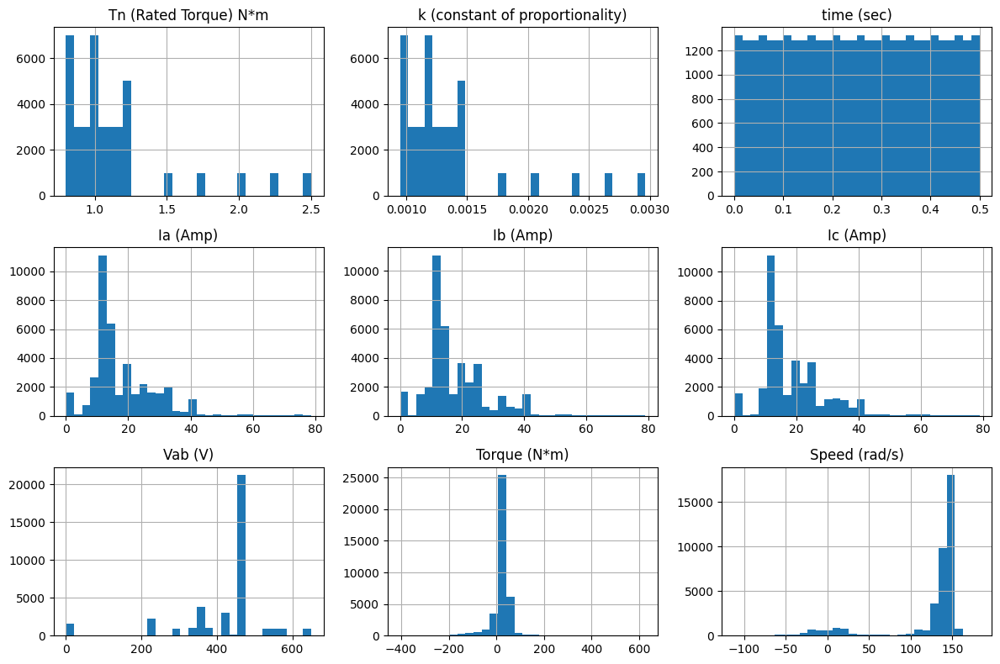

In [ ]:
import matplotlib.pyplot as plt

df.drop(columns=['Category'], errors='ignore').hist(figsize=(12, 8), bins=30)

plt.tight_layout()
plt.show()


In [ ]:
import numpy as np

def detect_outliers_iqr(df):
    Q1 = df.quantile(0.25)
    Q3 = df.quantile(0.75)
    IQR = Q3 - Q1


    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    # Detect outliers
    outliers = ((df < lower_bound) | (df > upper_bound))

    return outliers


outliers = detect_outliers_iqr(df.drop(columns=['Category'], errors='ignore'))

# Filter out the rows that contain outliers
df_capped = df[~outliers.any(axis=1)]

# Display the number of outliers removed and the new DataFrame
print(f"Number of outliers removed: {outliers.any(axis=1).sum()}")
print(df_capped.head())


Number of outliers removed: 14881
    Tn (Rated Torque) N*m  k (constant of proportionality)  time (sec)  \
40                    0.8                         0.000948      0.0200   
41                    0.8                         0.000948      0.0205   
42                    0.8                         0.000948      0.0210   
43                    0.8                         0.000948      0.0215   
44                    0.8                         0.000948      0.0220   

     Ia (Amp)   Ib (Amp)   Ic (Amp)     Vab (V)  Torque (N*m)  Speed (rad/s)  \
40  31.675789  35.037729  37.444575  474.560056     29.384258     110.351189   
41  31.928593  34.811621  37.407403  474.560037     38.251311     111.319801   
42  31.831172  34.554070  37.431604  474.560163     41.994577     112.339622   
43  31.387639  34.320600  37.410087  474.560269     39.533481     113.562823   
44  30.631608  34.146123  37.252304  474.560236     51.302298     114.804205   

    Category  
40         0  
41        

In [ ]:
df_capped

,Tn (Rated Torque) N*m,k (constant of proportionality),time (sec),Ia (Amp),Ib (Amp),Ic (Amp),Vab (V),Torque (N*m),Speed (rad/s),Category
40,0.800,0.000948,0.0200,31.675789,35.037729,37.444575,474.560056,29.384258,110.351189,0
41,0.800,0.000948,0.0205,31.928593,34.811621,37.407403,474.560037,38.251311,111.319801,0
42,0.800,0.000948,0.0210,31.831172,34.554070,37.431604,474.560163,41.994577,112.339622,0
43,0.800,0.000948,0.0215,31.387639,34.320600,37.410087,474.560269,39.533481,113.562823,0
44,0.800,0.000948,0.0220,30.631608,34.146123,37.252304,474.560236,51.302298,114.804205,0
...,...,...,...,...,...,...,...,...,...,...
39034,1.225,0.001452,0.4980,19.498014,19.498017,19.497990,303.079346,22.913909,125.586379,5
39035,1.225,0.001452,0.4985,19.498015,19.498017,19.497991,303.079346,25.483203,125.619796,5
39036,1.225,0.001452,0.4990,19.498016,19.498017,19.497991,303.079346,22.234266,125.586156,5
39037,1.225,0.001452,0.4995,19.498017,19.498017,19.497992,303.079346,25.014669,125.614818,5


In [ ]:
from scipy.stats import f_oneway

X = df_capped .drop(columns=['Category'])
y = df_capped ['Category']

anova_results = {}
alpha = 0.10

for col in X.select_dtypes(include=['float64', 'int64']).columns:
    groups = [X[y == category][col] for category in y.unique()]
    f_stat, p_value = f_oneway(*groups)
    anova_results[col] = {'f_stat': f_stat, 'p-value': p_value, 'significant': p_value < alpha}

anova_df = pd.DataFrame.from_dict(anova_results, orient='index')
print(anova_df)


                                       f_stat  p-value  significant
Tn (Rated Torque) N*m             2940.344642      0.0         True
k (constant of proportionality)   2926.400588      0.0         True
time (sec)                         464.783618      0.0         True
Ia (Amp)                          5527.194205      0.0         True
Ib (Amp)                           343.854130      0.0         True
Ic (Amp)                                  NaN      NaN        False
Vab (V)                          48014.923047      0.0         True
Torque (N*m)                       391.094387      0.0         True
Speed (rad/s)                     3539.528201      0.0         True


In [ ]:
df_capped = df_capped.drop(columns=['time (sec)', 'Ic (Amp)'], errors='ignore')

In [ ]:
from sklearn.model_selection import train_test_split


train_df, test_df = train_test_split(df_capped, test_size=0.20, random_state=42)

# Display the split dataframes
print("Training DataFrame shape:", train_df.shape)
print("Testing DataFrame shape:", test_df.shape)


Training DataFrame shape: (19324, 8)
Testing DataFrame shape: (4832, 8)


In [ ]:
# Check value counts of 'Category' in both train_df and test_df
train_category_counts = train_df['Category'].value_counts()
test_category_counts = test_df['Category'].value_counts()

# Display the results
print("Category distribution in training set:")
print(train_category_counts)

print("\nCategory distribution in testing set:")
print(test_category_counts)


Category distribution in training set:
Category
0    9770
4    3409
5    2306
2    2191
3     902
1     746
Name: count, dtype: int64

Category distribution in testing set:
Category
0    2483
4     826
5     569
2     551
3     218
1     185
Name: count, dtype: int64


Optimal number of features: 4
Selected features: Index(['Tn (Rated Torque) N*m', 'Ia (Amp)', 'Vab (V)', 'Speed (rad/s)'], dtype='object')


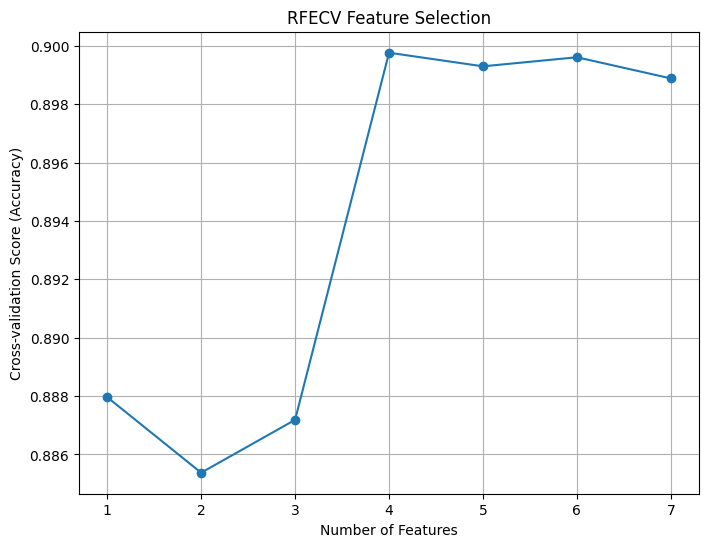

Final selected features: Index(['Tn (Rated Torque) N*m', 'Ia (Amp)', 'Vab (V)', 'Speed (rad/s)'], dtype='object')


In [ ]:
import matplotlib.pyplot as plt
from sklearn.feature_selection import RFECV
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import StratifiedKFold

# Define feature matrix (X) and target variable (y)
X_train = train_df.drop(columns=['Category'])
y_train = train_df['Category']

# Initialize the Random Forest classifier (or any other classifier you'd like)
clf = RandomForestClassifier(n_estimators=100, random_state=42)

# Initialize StratifiedKFold cross-validation with 5 folds
cv = StratifiedKFold(n_splits=5)

# Perform RFECV for feature selection
selector = RFECV(estimator=clf, step=1, cv=cv, scoring='accuracy')
selector = selector.fit(X_train, y_train)

# Get the optimal number of features and the selected features
optimal_num_features = selector.n_features_
selected_features = X_train.columns[selector.support_]

# Print the results
print(f"Optimal number of features: {optimal_num_features}")
print(f"Selected features: {selected_features}")

# Plot the RFECV performance curve for each number of features
plt.figure(figsize=(8, 6))
plt.plot(range(1, len(selector.cv_results_['mean_test_score']) + 1),
         selector.cv_results_['mean_test_score'], marker='o')
plt.xlabel("Number of Features")
plt.ylabel("Cross-validation Score (Accuracy)")
plt.title("RFECV Feature Selection")
plt.grid(True)
plt.show()

# Final feature selection based on cross-validation score
final_selected_features = selected_features[:min(optimal_num_features, 7)]
print(f"Final selected features: {final_selected_features}")


In [ ]:
from imblearn.over_sampling import SMOTE
from collections import Counter

# Define feature matrix (X) and target (y)
X_train = train_df.drop(columns=['Category'])
y_train = train_df['Category']

# Initialize SMOTE for multi-class balancing
smote = SMOTE(sampling_strategy='auto', random_state=42)

# Apply SMOTE
X_resampled, y_resampled = smote.fit_resample(X_train, y_train)

# Convert back to DataFrame
train_df_balanced = pd.DataFrame(X_resampled, columns=X_train.columns)
train_df_balanced['Category'] = y_resampled

# Check class distribution
print("Class distribution after SMOTE:")
print(Counter(y_resampled))

# Ensure total samples = 9779
if len(train_df_balanced) > 9770:
    train_df_balanced = train_df_balanced.sample(n=9770, random_state=42)
elif len(train_df_balanced) < 9770:
    print(f"Warning: Balancing resulted in {len(train_df_balanced)} samples, less than 9770.")


Class distribution after SMOTE:
Counter({0: 9770, 2: 9770, 3: 9770, 5: 9770, 4: 9770, 1: 9770})


In [ ]:
from sklearn.preprocessing import StandardScaler

# Initialize StandardScaler
scaler = StandardScaler()

# Select numeric columns (excluding 'Category')
numeric_cols = train_df_balanced.drop(columns=['Category']).columns

# Fit scaler on training data and transform both train and test sets
train_df_balanced[numeric_cols] = scaler.fit_transform(train_df_balanced[numeric_cols])
test_df[numeric_cols] = scaler.transform(test_df[numeric_cols])

# Display first few rows to verify standardization
print("Standardized Train Data:\n", train_df_balanced.head())
print("Standardized Test Data:\n", test_df.head())


Standardized Train Data:
        Tn (Rated Torque) N*m  k (constant of proportionality)  Ia (Amp)  \
26541               1.918865                         1.917888  0.012263   
8588               -1.248609                        -1.243596 -0.959479   
54174              -1.248609                        -1.243596 -0.773687   
55044              -1.248609                        -1.243596 -0.774002   
53438              -1.022361                        -1.018048 -0.407411   

       Ib (Amp)   Vab (V)  Torque (N*m)  Speed (rad/s)  Category  
26541  0.265821  0.210086      1.386625      -0.108680         1  
8588  -0.740333  0.203891      0.065967       0.744111         0  
54174 -0.546564 -1.056057     -0.478351       0.250825         5  
55044 -0.546401 -1.056057     -0.214798       0.258211         5  
53438 -0.195402 -1.698887     -0.272729      -0.332754         5  
Standardized Test Data:
        Tn (Rated Torque) N*m  k (constant of proportionality)  Ia (Amp)  \
3506               -0

In [ ]:
pip install catboost

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.7/98.7 MB 9.5 MB/s eta 0:00:00


In [ ]:
import time
from sklearn.metrics import classification_report
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier, AdaBoostClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from catboost import CatBoostClassifier
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score

# Select only the specified features for training
features = ['Tn (Rated Torque) N*m', 'Ia (Amp)', 'Vab (V)', 'Speed (rad/s)']
X_balanced = train_df_balanced[features]
y_balanced = train_df_balanced['Category']

# Define the classifiers
classifiers = {
    "Random Forest": RandomForestClassifier(n_estimators=100, max_depth=10, min_samples_split=4, random_state=42),
    "Decision Tree": DecisionTreeClassifier(max_depth=10, min_samples_split=4, random_state=42),
    "Extra Trees": ExtraTreesClassifier(n_estimators=100, max_depth=10, min_samples_split=4, random_state=42),
    "KNN": KNeighborsClassifier(n_neighbors=5, weights='uniform'),
    "MLP": MLPClassifier(hidden_layer_sizes=(128,), max_iter=1000, alpha=0.001, solver='adam', random_state=42),
    "CatBoost": CatBoostClassifier(iterations=500, learning_rate=0.1, depth=6, l2_leaf_reg=10, early_stopping_rounds=50, random_state=42, verbose=0),
    "XGBoost": XGBClassifier(n_estimators=100, max_depth=6, learning_rate=0.1, alpha=0.01, gamma=0, random_state=42)
}

# Train classifiers and evaluate on the balanced dataset (training report only)
for clf_name, clf in classifiers.items():
    print(f"\nTraining {clf_name}...")

    # Record the start time
    start_time = time.time()

    clf.fit(X_balanced, y_balanced)

    # Record the end time and calculate the training time
    end_time = time.time()
    training_time = end_time - start_time

    # Predict on training set
    y_train_pred = clf.predict(X_balanced)

    print(f"\n{clf_name} Training Classification Report:")
    print(classification_report(y_balanced, y_train_pred, digits=4))

    # Print training time
    print(f"Training Time: {training_time:.4f} seconds")



Training Random Forest...

Random Forest Training Classification Report:
              precision    recall  f1-score   support

           0     0.9386    0.9112    0.9247      1610
           1     1.0000    1.0000    1.0000      1594
           2     1.0000    1.0000    1.0000      1621
           3     0.9396    0.9659    0.9526      1612
           4     0.9646    0.9658    0.9652      1636
           5     1.0000    1.0000    1.0000      1697

    accuracy                         0.9740      9770
   macro avg     0.9738    0.9738    0.9737      9770
weighted avg     0.9740    0.9740    0.9739      9770

Training Time: 1.3660 seconds

Training Decision Tree...

Decision Tree Training Classification Report:
              precision    recall  f1-score   support

           0     0.8689    0.9137    0.8907      1610
           1     1.0000    1.0000    1.0000      1594
           2     1.0000    1.0000    1.0000      1621
           3     0.9399    0.9119    0.9257      1612
        


Training Random Forest...
5-Fold Cross-Validation Accuracy for Random Forest: [0.96212897 0.96622313 0.96417605 0.9667349  0.96827021]
Mean CV Accuracy: 0.9655
Standard Deviation of CV Accuracy: 0.0021
Training Time: 9.5675 seconds


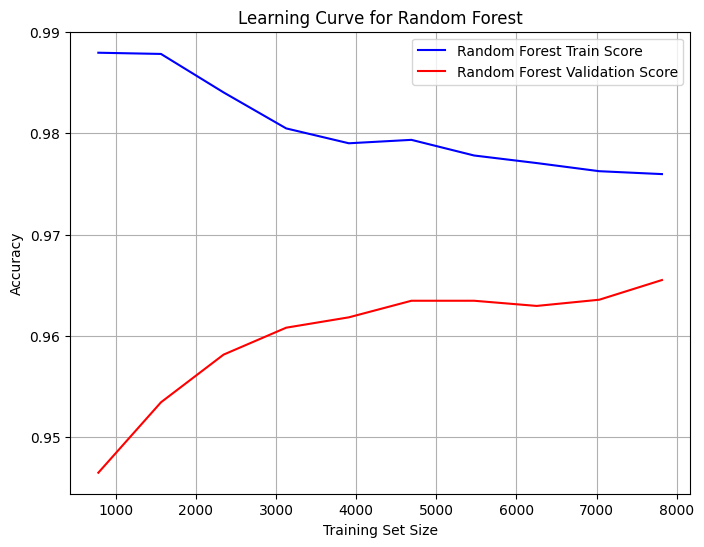


Training Decision Tree...
5-Fold Cross-Validation Accuracy for Decision Tree: [0.95342886 0.9580348  0.95342886 0.94831116 0.95496418]
Mean CV Accuracy: 0.9536
Standard Deviation of CV Accuracy: 0.0031
Training Time: 0.1688 seconds


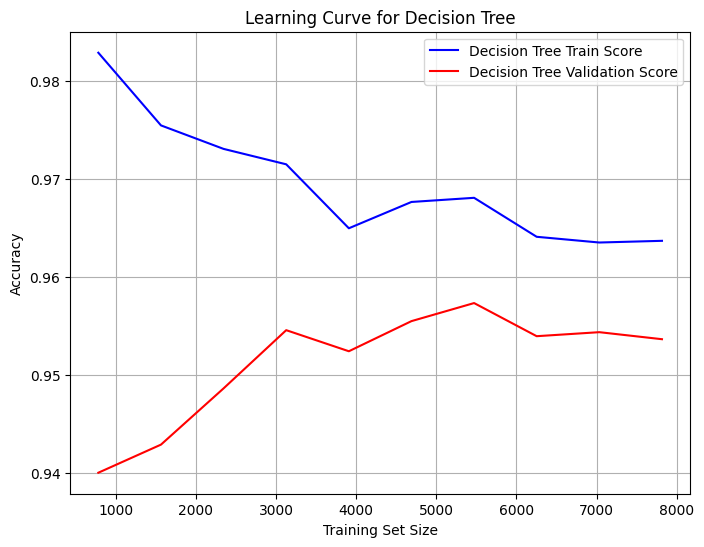


Training Extra Trees...
5-Fold Cross-Validation Accuracy for Extra Trees: [0.95138178 0.94677584 0.95240532 0.94472876 0.95752303]
Mean CV Accuracy: 0.9506
Standard Deviation of CV Accuracy: 0.0045
Training Time: 1.6664 seconds


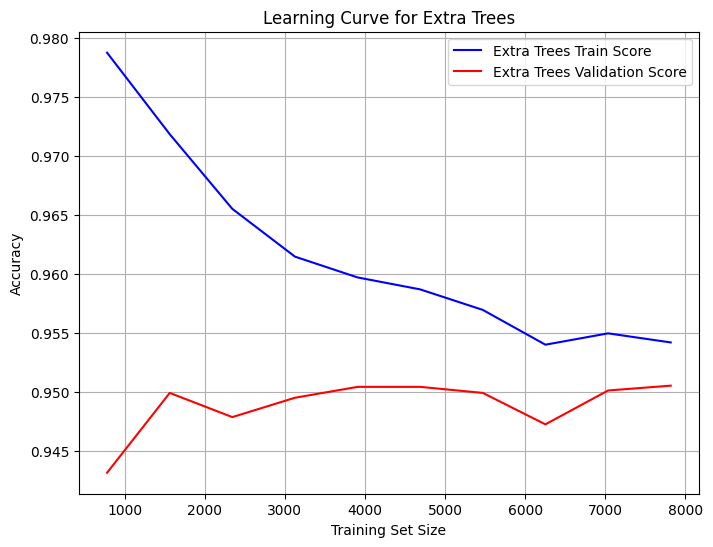


Training KNN...
5-Fold Cross-Validation Accuracy for KNN: [0.94728762 0.9493347  0.95394063 0.94984647 0.95957011]
Mean CV Accuracy: 0.9520
Standard Deviation of CV Accuracy: 0.0044
Training Time: 0.6191 seconds


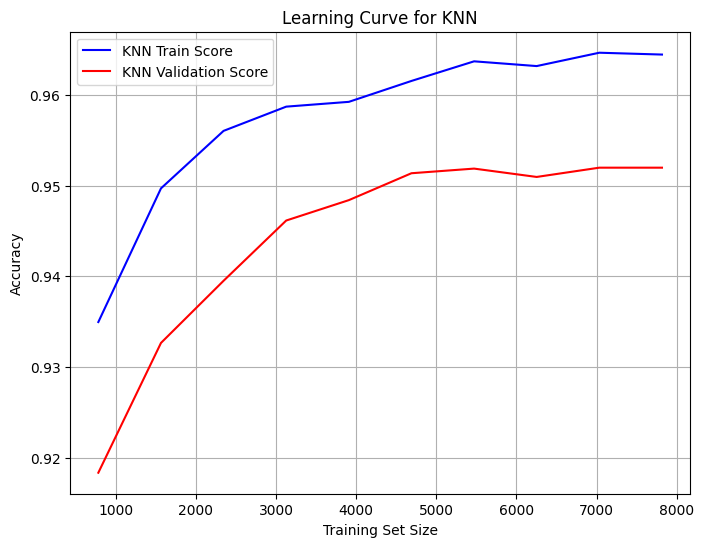


Training MLP...
5-Fold Cross-Validation Accuracy for MLP: [0.9457523  0.93858751 0.9457523  0.94421699 0.95035824]
Mean CV Accuracy: 0.9449
Standard Deviation of CV Accuracy: 0.0038
Training Time: 55.7080 seconds


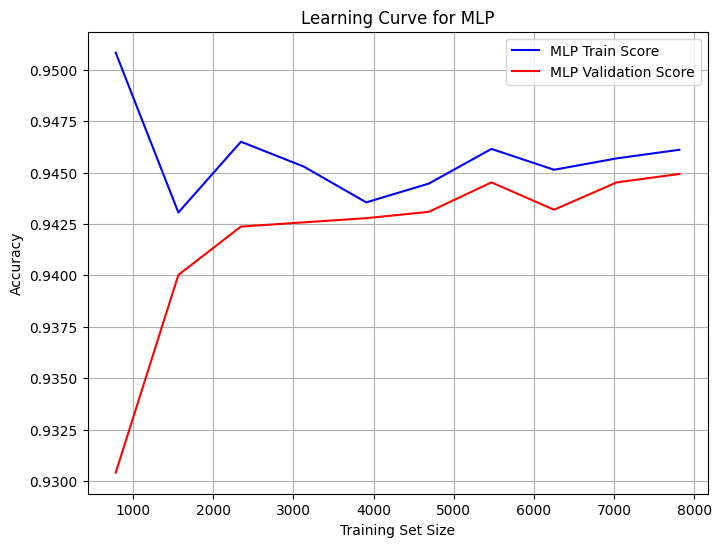


Training CatBoost...
5-Fold Cross-Validation Accuracy for CatBoost: [0.9667349  0.96878199 0.96980553 0.97134084 0.97594678]
Mean CV Accuracy: 0.9705
Standard Deviation of CV Accuracy: 0.0031
Training Time: 27.0207 seconds


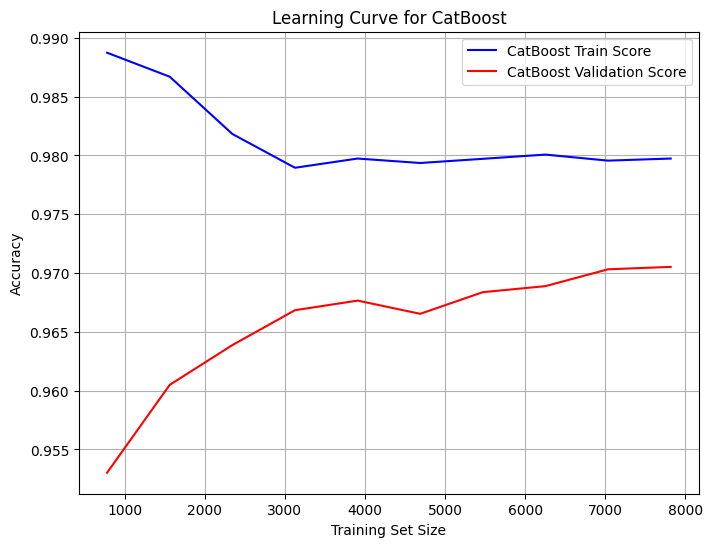


Training XGBoost...
5-Fold Cross-Validation Accuracy for XGBoost: [0.97082907 0.97185261 0.97185261 0.97236438 0.97236438]
Mean CV Accuracy: 0.9719
Standard Deviation of CV Accuracy: 0.0006
Training Time: 2.5707 seconds


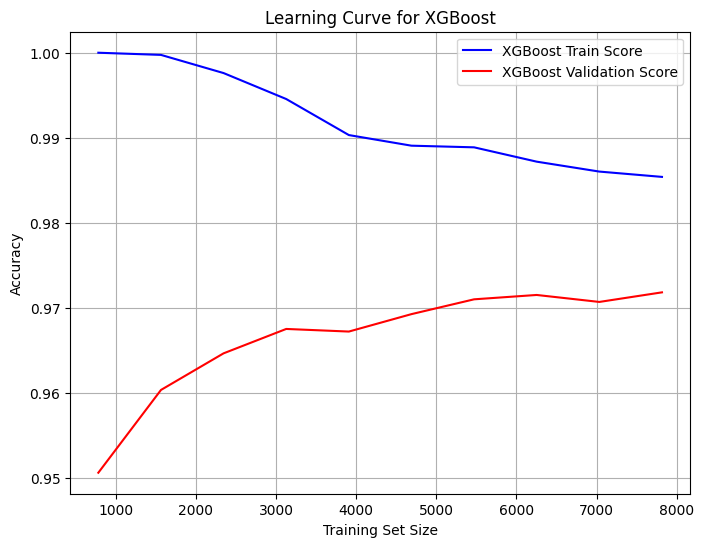

In [ ]:
import time
import numpy as np
from sklearn.model_selection import cross_val_score, learning_curve
from sklearn.metrics import classification_report
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

# Select only the specified features for training
features = ['Tn (Rated Torque) N*m', 'Ia (Amp)', 'Vab (V)', 'Speed (rad/s)']
X_balanced = train_df_balanced[features]
y_balanced = train_df_balanced['Category']

# Define the classifiers
classifiers = {
    "Random Forest": RandomForestClassifier(n_estimators=100, max_depth=10, min_samples_split=4, random_state=42),
    "Decision Tree": DecisionTreeClassifier(max_depth=10, min_samples_split=4, random_state=42),
    "Extra Trees": ExtraTreesClassifier(n_estimators=100, max_depth=10, min_samples_split=4, random_state=42),
    "KNN": KNeighborsClassifier(n_neighbors=5, weights='uniform'),
    "MLP": MLPClassifier(hidden_layer_sizes=(128,), max_iter=1000, alpha=0.001, solver='adam', random_state=42),
    "CatBoost": CatBoostClassifier(iterations=500, learning_rate=0.1, depth=6, l2_leaf_reg=10, early_stopping_rounds=50, random_state=42, verbose=0),
    "XGBoost": XGBClassifier(n_estimators=100, max_depth=6, learning_rate=0.1, alpha=0.01, gamma=0, random_state=42)
}

# Train classifiers and evaluate using 5-fold CV
for clf_name, clf in classifiers.items():
    print(f"\nTraining {clf_name}...")

    # Record the start time
    start_time = time.time()

    # Cross-validation (5 folds)
    cv_accuracy = cross_val_score(clf, X_balanced, y_balanced, cv=5, scoring='accuracy')

    # Record the end time and calculate the training time
    end_time = time.time()
    training_time = end_time - start_time

    # Display the cross-validation results
    print(f"5-Fold Cross-Validation Accuracy for {clf_name}: {cv_accuracy}")
    print(f"Mean CV Accuracy: {np.mean(cv_accuracy):.4f}")
    print(f"Standard Deviation of CV Accuracy: {np.std(cv_accuracy):.4f}")
    print(f"Training Time: {training_time:.4f} seconds")

    # Learning Curve (train sizes vs. accuracy)
    train_sizes, train_scores, valid_scores = learning_curve(clf, X_balanced, y_balanced, cv=5, scoring='accuracy', n_jobs=-1, train_sizes=np.linspace(0.1, 1.0, 10))

    # Plot learning curve
    plt.figure(figsize=(8, 6))
    plt.plot(train_sizes, np.mean(train_scores, axis=1), label=f'{clf_name} Train Score', color='b')
    plt.plot(train_sizes, np.mean(valid_scores, axis=1), label=f'{clf_name} Validation Score', color='r')
    plt.title(f"Learning Curve for {clf_name}")
    plt.xlabel("Training Set Size")
    plt.ylabel("Accuracy")
    plt.legend(loc="best")
    plt.grid(True)
    plt.show()



Training Random Forest...

Random Forest Test Classification Report:
              precision    recall  f1-score   support

           0     0.9851    0.9058    0.9438      2483
           1     1.0000    1.0000    1.0000       185
           2     1.0000    1.0000    1.0000       551
           3     0.5977    0.9404    0.7308       218
           4     0.8901    0.9709    0.9288       826
           5     1.0000    1.0000    1.0000       569

    accuracy                         0.9439      4832
   macro avg     0.9121    0.9695    0.9339      4832
weighted avg     0.9554    0.9439    0.9468      4832


Random Forest Accuracy: 0.9439

Random Forest AUC Score: 0.9958
Random Forest - Average Precision (AP) for class 0: 0.9935
Random Forest - Average Precision (AP) for class 1: 1.0000
Random Forest - Average Precision (AP) for class 2: 1.0000
Random Forest - Average Precision (AP) for class 3: 0.6917
Random Forest - Average Precision (AP) for class 4: 0.9842
Random Forest - Average Pre

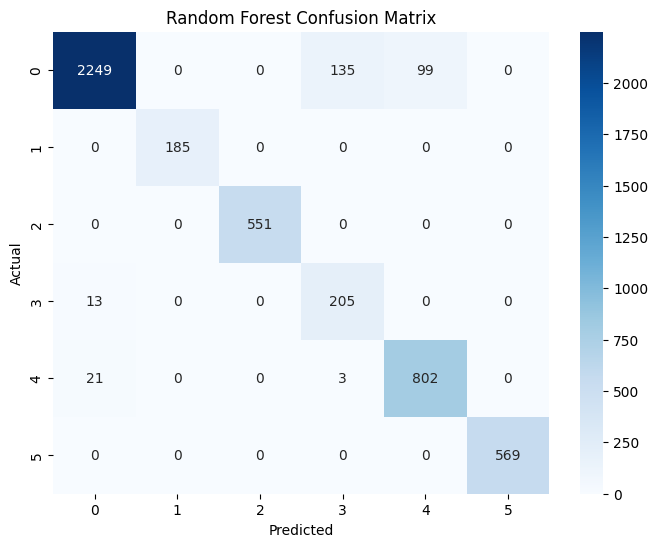

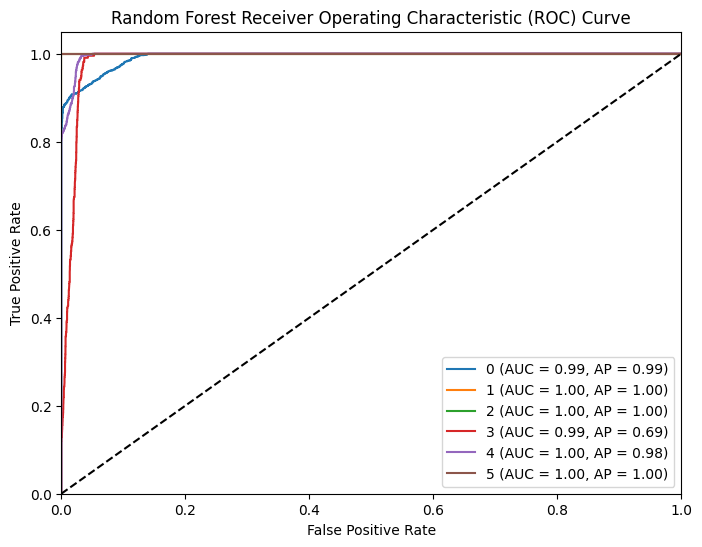

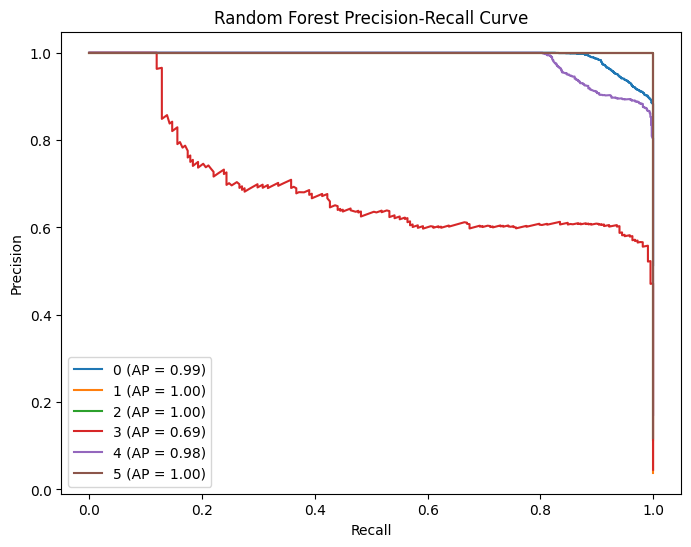


Training Decision Tree...

Decision Tree Test Classification Report:
              precision    recall  f1-score   support

           0     0.9700    0.9122    0.9402      2483
           1     1.0000    1.0000    1.0000       185
           2     1.0000    1.0000    1.0000       551
           3     0.6106    0.8991    0.7273       218
           4     0.8921    0.9407    0.9157       826
           5     1.0000    1.0000    1.0000       569

    accuracy                         0.9402      4832
   macro avg     0.9121    0.9587    0.9305      4832
weighted avg     0.9486    0.9402    0.9426      4832


Decision Tree Accuracy: 0.9402

Decision Tree AUC Score: 0.9927
Decision Tree - Average Precision (AP) for class 0: 0.9785
Decision Tree - Average Precision (AP) for class 1: 1.0000
Decision Tree - Average Precision (AP) for class 2: 1.0000
Decision Tree - Average Precision (AP) for class 3: 0.7198
Decision Tree - Average Precision (AP) for class 4: 0.9671
Decision Tree - Average Pre

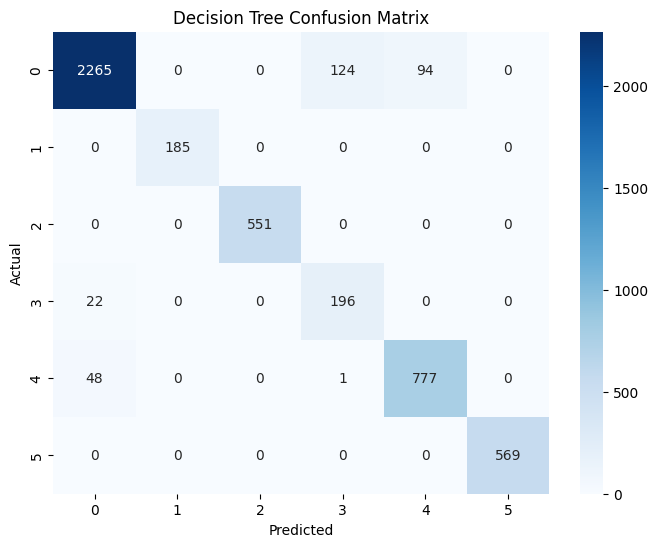

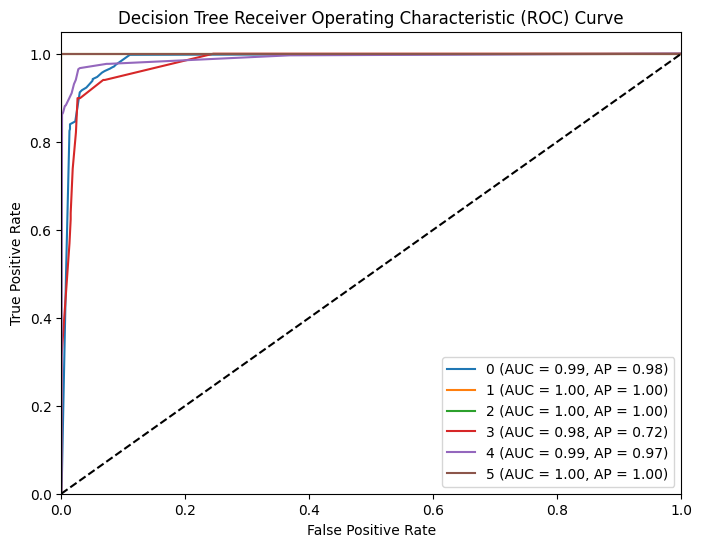

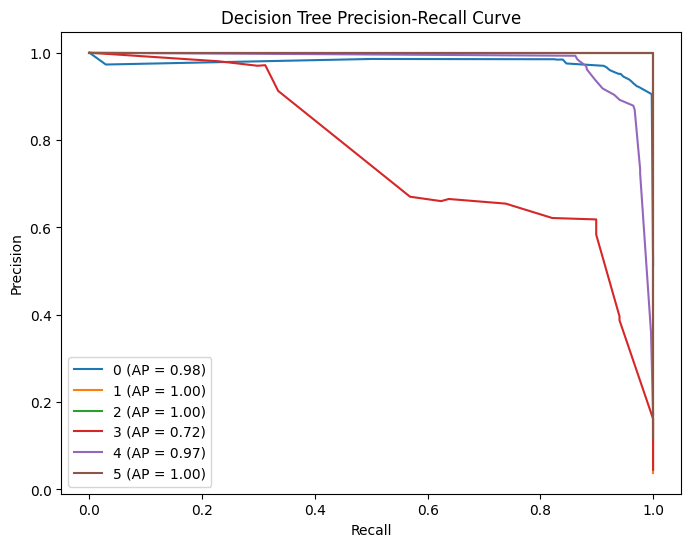


Training Extra Trees...

Extra Trees Test Classification Report:
              precision    recall  f1-score   support

           0     0.9659    0.9227    0.9438      2483
           1     1.0000    1.0000    1.0000       185
           2     1.0000    1.0000    1.0000       551
           3     0.5099    0.9450    0.6624       218
           4     0.9374    0.8523    0.8928       826
           5     1.0000    1.0000    1.0000       569

    accuracy                         0.9325      4832
   macro avg     0.9022    0.9533    0.9165      4832
weighted avg     0.9496    0.9325    0.9376      4832


Extra Trees Accuracy: 0.9325

Extra Trees AUC Score: 0.9934
Extra Trees - Average Precision (AP) for class 0: 0.9828
Extra Trees - Average Precision (AP) for class 1: 1.0000
Extra Trees - Average Precision (AP) for class 2: 1.0000
Extra Trees - Average Precision (AP) for class 3: 0.5704
Extra Trees - Average Precision (AP) for class 4: 0.9783
Extra Trees - Average Precision (AP) for clas

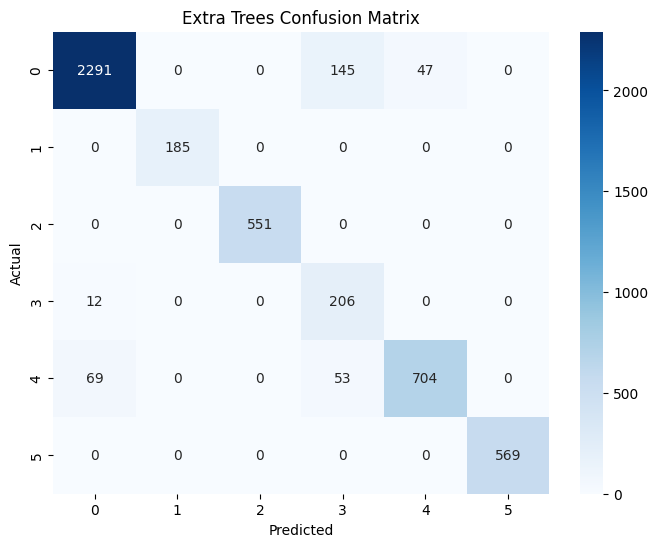

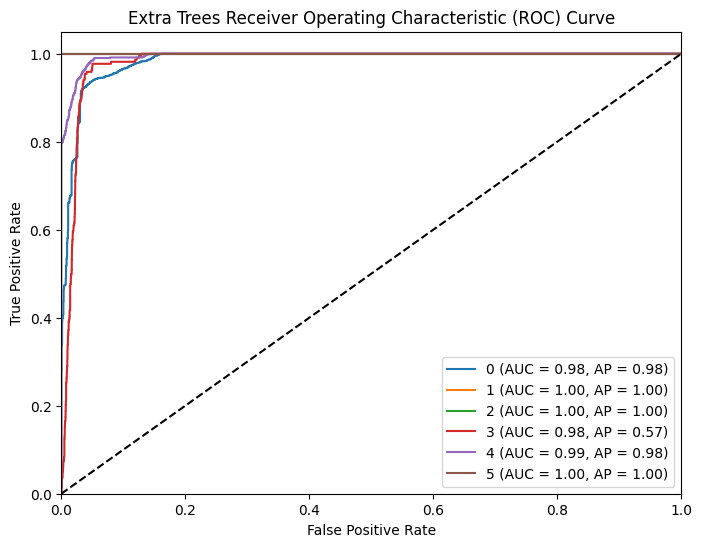

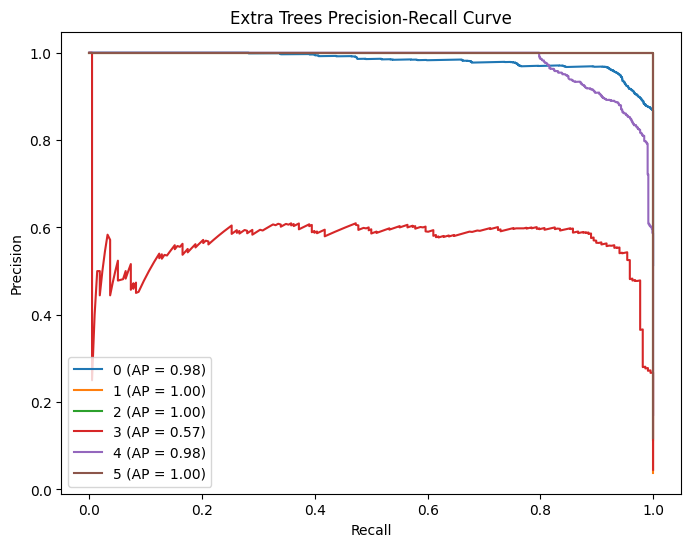


Training KNN...

KNN Test Classification Report:
              precision    recall  f1-score   support

           0     0.9799    0.8820    0.9284      2483
           1     1.0000    1.0000    1.0000       185
           2     1.0000    1.0000    1.0000       551
           3     0.5012    0.9220    0.6494       218
           4     0.8466    0.9153    0.8796       826
           5     1.0000    0.9965    0.9982       569

    accuracy                         0.9209      4832
   macro avg     0.8879    0.9526    0.9093      4832
weighted avg     0.9409    0.9209    0.9266      4832


KNN Accuracy: 0.9209

KNN AUC Score: 0.9877
KNN - Average Precision (AP) for class 0: 0.9720
KNN - Average Precision (AP) for class 1: 1.0000
KNN - Average Precision (AP) for class 2: 1.0000
KNN - Average Precision (AP) for class 3: 0.5060
KNN - Average Precision (AP) for class 4: 0.9378
KNN - Average Precision (AP) for class 5: 1.0000


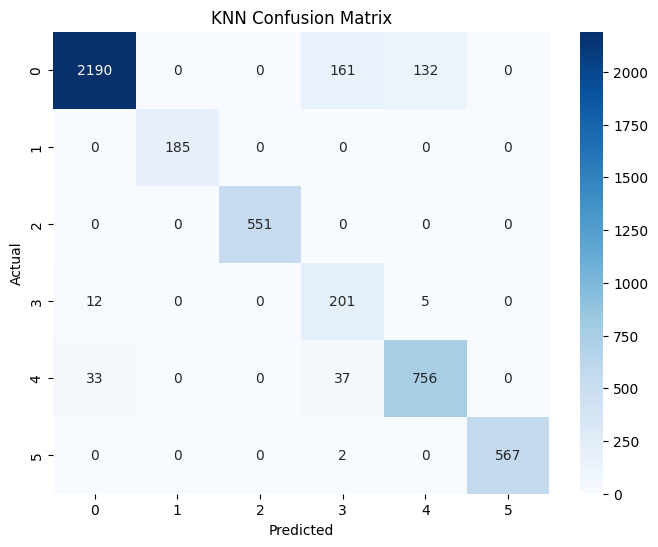

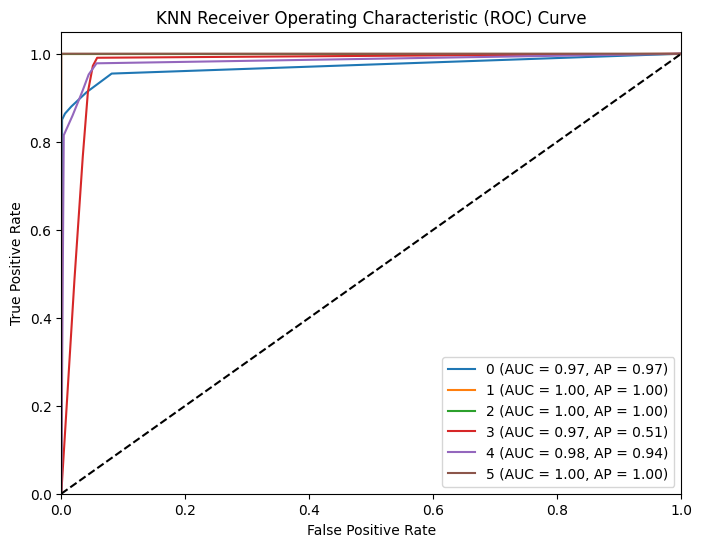

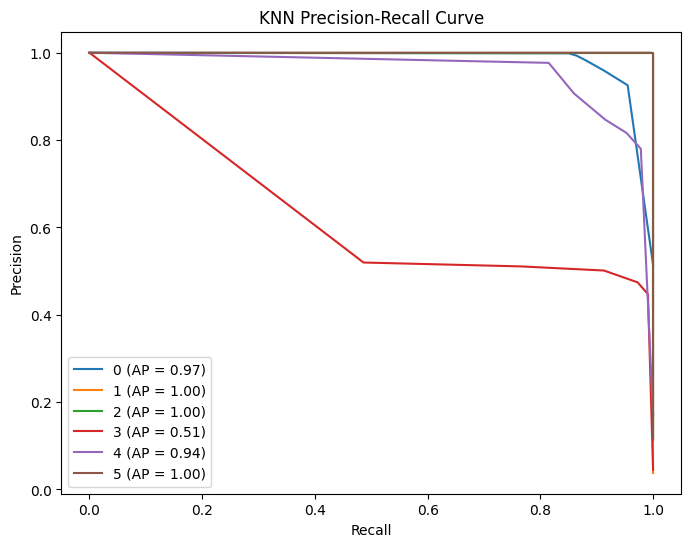


Training MLP...

MLP Test Classification Report:
              precision    recall  f1-score   support

           0     0.9847    0.8808    0.9298      2483
           1     1.0000    1.0000    1.0000       185
           2     1.0000    1.0000    1.0000       551
           3     0.4941    0.9587    0.6521       218
           4     0.8494    0.9080    0.8777       826
           5     1.0000    1.0000    1.0000       569

    accuracy                         0.9212      4832
   macro avg     0.8880    0.9579    0.9099      4832
weighted avg     0.9436    0.9212    0.9273      4832


MLP Accuracy: 0.9212

MLP AUC Score: 0.9942
MLP - Average Precision (AP) for class 0: 0.9916
MLP - Average Precision (AP) for class 1: 1.0000
MLP - Average Precision (AP) for class 2: 1.0000
MLP - Average Precision (AP) for class 3: 0.6401
MLP - Average Precision (AP) for class 4: 0.9694
MLP - Average Precision (AP) for class 5: 1.0000


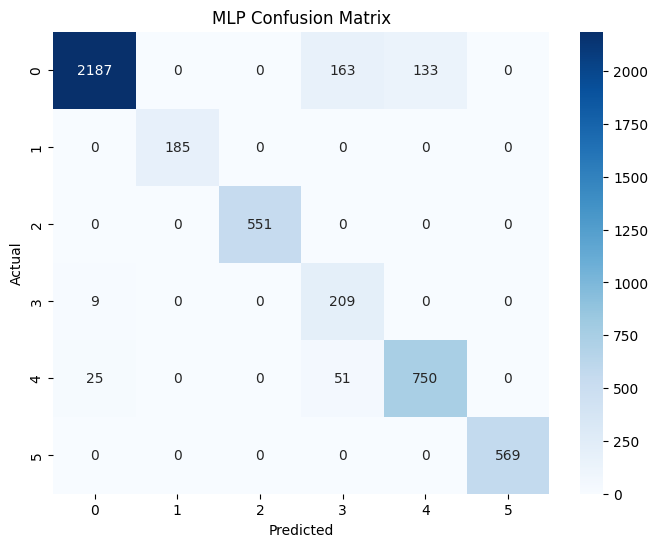

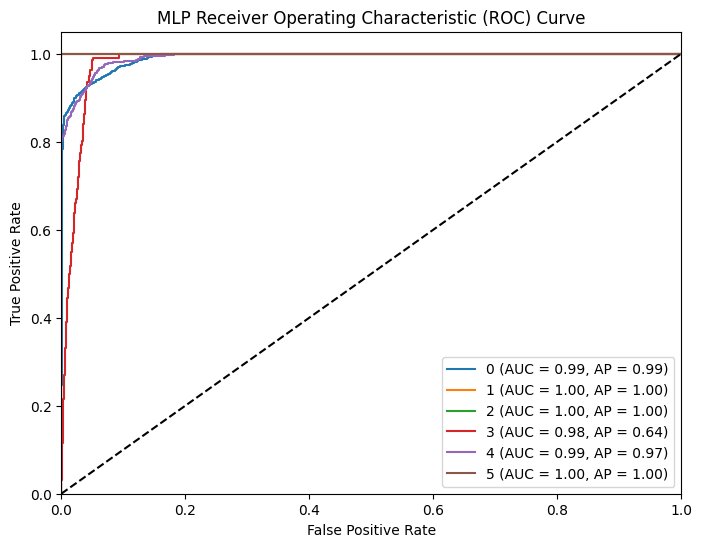

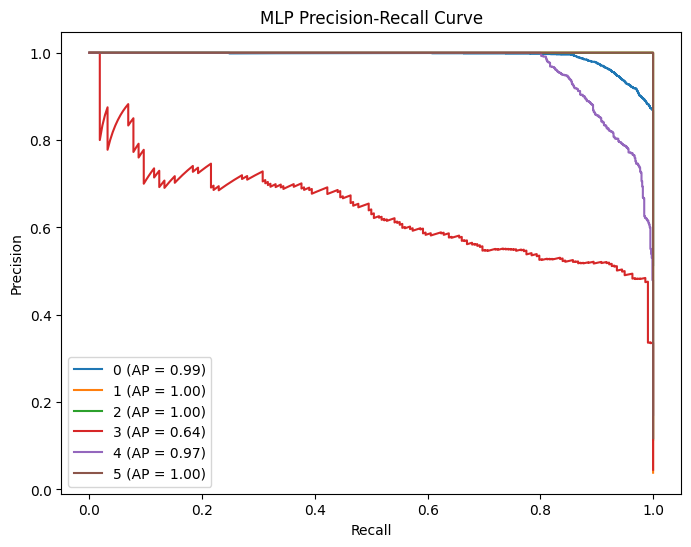


Training CatBoost...

CatBoost Test Classification Report:
              precision    recall  f1-score   support

           0     0.9847    0.9070    0.9442      2483
           1     1.0000    1.0000    1.0000       185
           2     1.0000    1.0000    1.0000       551
           3     0.6083    0.9404    0.7387       218
           4     0.8904    0.9734    0.9300       826
           5     1.0000    1.0000    1.0000       569

    accuracy                         0.9450      4832
   macro avg     0.9139    0.9701    0.9355      4832
weighted avg     0.9557    0.9450    0.9476      4832


CatBoost Accuracy: 0.9450

CatBoost AUC Score: 0.9965
CatBoost - Average Precision (AP) for class 0: 0.9943
CatBoost - Average Precision (AP) for class 1: 1.0000
CatBoost - Average Precision (AP) for class 2: 1.0000
CatBoost - Average Precision (AP) for class 3: 0.7345
CatBoost - Average Precision (AP) for class 4: 0.9895
CatBoost - Average Precision (AP) for class 5: 1.0000


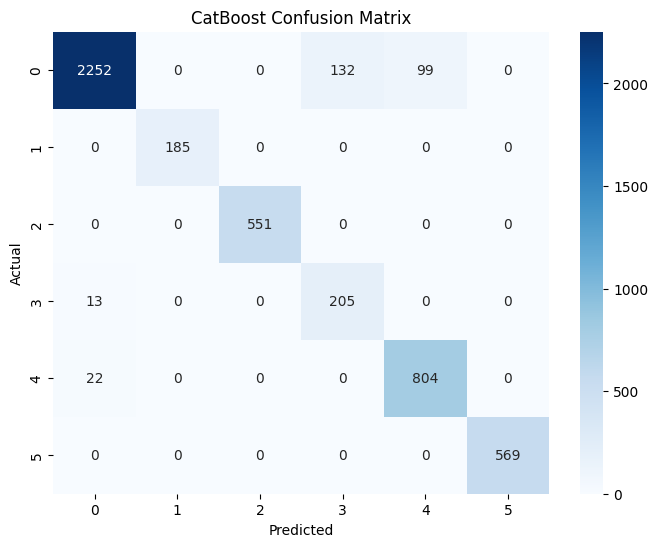

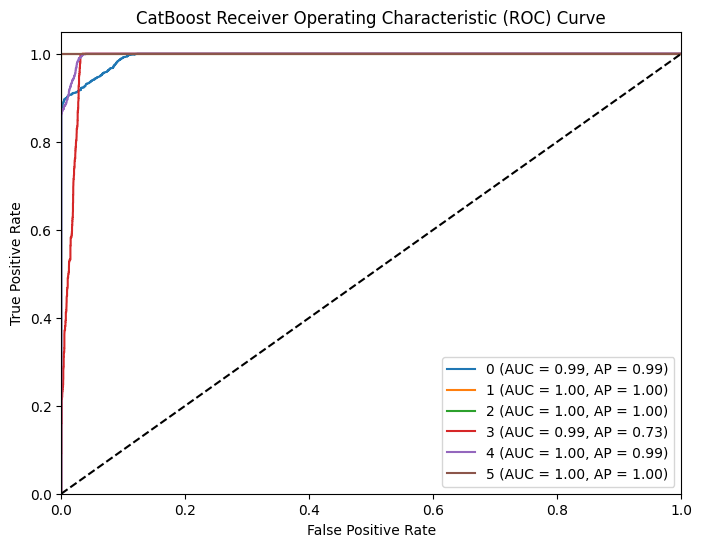

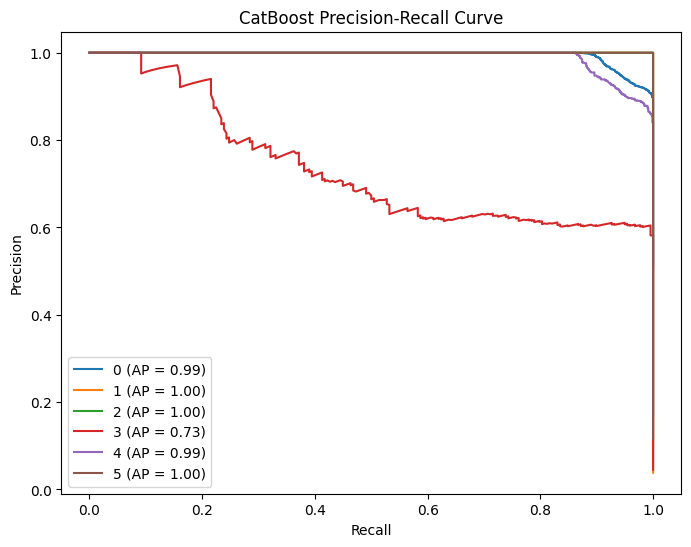


Training XGBoost...

XGBoost Test Classification Report:
              precision    recall  f1-score   support

           0     0.9821    0.9074    0.9433      2483
           1     1.0000    1.0000    1.0000       185
           2     1.0000    1.0000    1.0000       551
           3     0.6078    0.9312    0.7355       218
           4     0.8886    0.9661    0.9258       826
           5     0.9982    1.0000    0.9991       569

    accuracy                         0.9435      4832
   macro avg     0.9128    0.9674    0.9339      4832
weighted avg     0.9539    0.9435    0.9461      4832


XGBoost Accuracy: 0.9435

XGBoost AUC Score: 0.9964
XGBoost - Average Precision (AP) for class 0: 0.9940
XGBoost - Average Precision (AP) for class 1: 1.0000
XGBoost - Average Precision (AP) for class 2: 1.0000
XGBoost - Average Precision (AP) for class 3: 0.7631
XGBoost - Average Precision (AP) for class 4: 0.9894
XGBoost - Average Precision (AP) for class 5: 1.0000


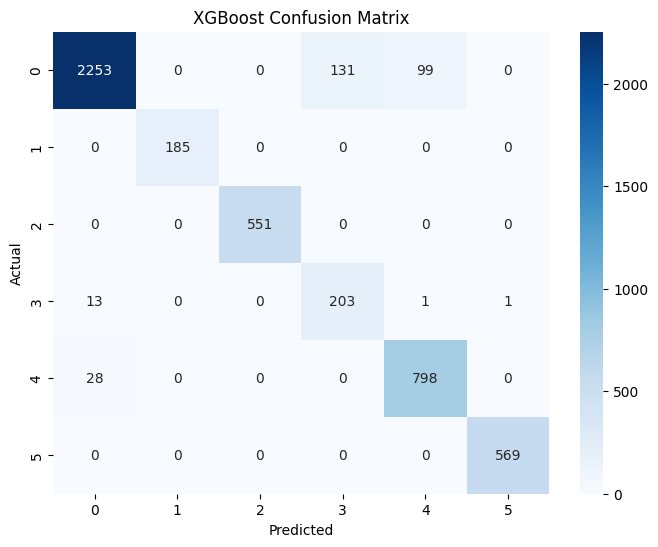

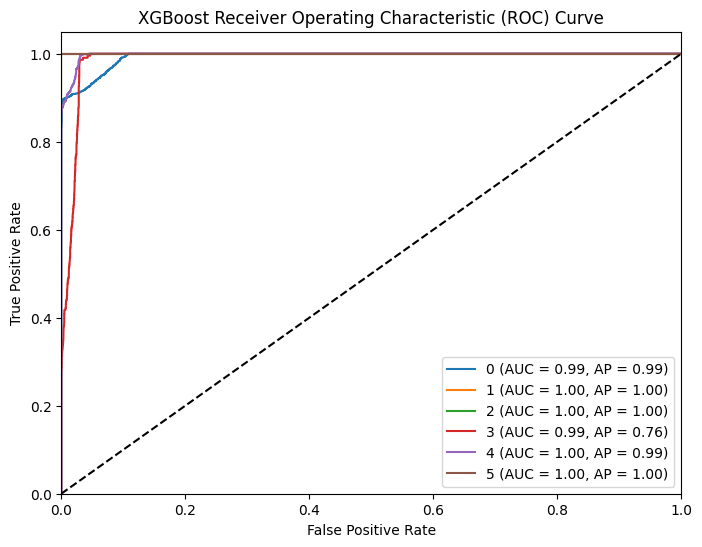

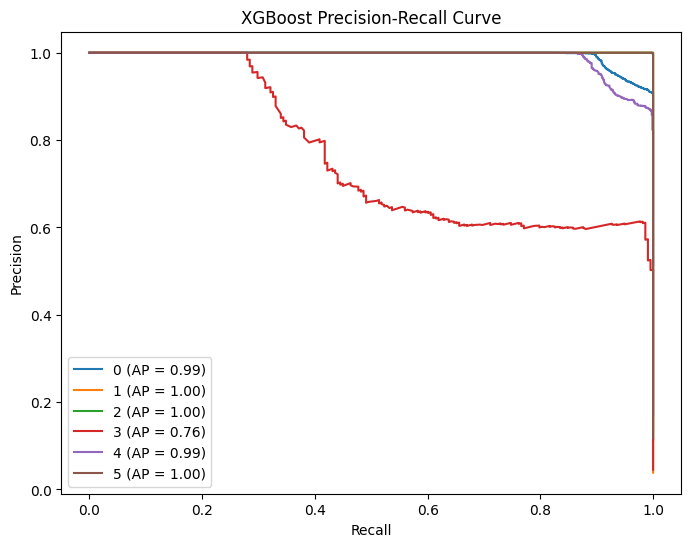

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, auc, precision_recall_curve, average_precision_score
from sklearn.preprocessing import LabelBinarizer
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import accuracy_score, roc_auc_score

X_test = test_df[features]
y_test = test_df['Category']
lb = LabelBinarizer()
y_test_bin = lb.fit_transform(y_test)

classifiers = {
    "Random Forest": RandomForestClassifier(n_estimators=100, max_depth=10, min_samples_split=4, random_state=42),
    "Decision Tree": DecisionTreeClassifier(max_depth=10, min_samples_split=4, random_state=42),
    "Extra Trees": ExtraTreesClassifier(n_estimators=100, max_depth=10, min_samples_split=4, random_state=42),
    "KNN": KNeighborsClassifier(n_neighbors=5, weights='uniform'),
    "MLP": MLPClassifier(hidden_layer_sizes=(128,), max_iter=1000, alpha=0.001, solver='adam', random_state=42),
    "CatBoost": CatBoostClassifier(iterations=500, learning_rate=0.1, depth=6, l2_leaf_reg=10, early_stopping_rounds=50, random_state=42, verbose=0),
    "XGBoost": XGBClassifier(n_estimators=100, max_depth=6, learning_rate=0.1, alpha=0.01, gamma=0, random_state=42)
}

for clf_name, clf in classifiers.items():
    print(f"\nTraining {clf_name}...")
    clf.fit(X_balanced, y_balanced)
    y_test_pred = clf.predict(X_test)
    y_prob = clf.predict_proba(X_test)

    print(f"\n{clf_name} Test Classification Report:")
    print(classification_report(y_test, y_test_pred, digits=4))

    accuracy = accuracy_score(y_test, y_test_pred)
    print(f"\n{clf_name} Accuracy: {accuracy:.4f}")

    try:
        auc_score = roc_auc_score(y_test_bin, y_prob, multi_class='ovr')
        print(f"\n{clf_name} AUC Score: {auc_score:.4f}")
    except AttributeError:
        print(f"\n{clf_name} does not support probability prediction for AUC computation.")

    ap_scores = {}
    for i in range(len(lb.classes_)):
        ap_scores[lb.classes_[i]] = average_precision_score(y_test_bin[:, i], y_prob[:, i])
        print(f"{clf_name} - Average Precision (AP) for class {lb.classes_[i]}: {ap_scores[lb.classes_[i]]:.4f}")

    cm = confusion_matrix(y_test, y_test_pred)
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=lb.classes_, yticklabels=lb.classes_)
    plt.title(f"{clf_name} Confusion Matrix")
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.show()

    plt.figure(figsize=(8, 6))
    fpr, tpr, roc_auc = {}, {}, {}
    for i in range(len(lb.classes_)):
        fpr[i], tpr[i], _ = roc_curve(y_test_bin[:, i], y_prob[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])
        plt.plot(fpr[i], tpr[i], label=f'{lb.classes_[i]} (AUC = {roc_auc[i]:.2f}, AP = {ap_scores[lb.classes_[i]]:.2f})')

    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.title(f"{clf_name} Receiver Operating Characteristic (ROC) Curve")
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.legend(loc='lower right')
    plt.show()

    plt.figure(figsize=(8, 6))
    for i in range(len(lb.classes_)):
        precision, recall, _ = precision_recall_curve(y_test_bin[:, i], y_prob[:, i])
        plt.plot(recall, precision, label=f'{lb.classes_[i]} (AP = {ap_scores[lb.classes_[i]]:.2f})')

    plt.title(f"{clf_name} Precision-Recall Curve")
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.legend(loc='lower left')
    plt.show()


In [ ]:
from sklearn.metrics import confusion_matrix

classifiers = {
    "Random Forest": RandomForestClassifier(n_estimators=100, max_depth=10, min_samples_split=4, random_state=42),
    "Decision Tree": DecisionTreeClassifier(max_depth=10, min_samples_split=4, random_state=42),
    "Extra Trees": ExtraTreesClassifier(n_estimators=100, max_depth=10, min_samples_split=4, random_state=42),
    "KNN": KNeighborsClassifier(n_neighbors=5, weights='uniform'),
    "MLP": MLPClassifier(hidden_layer_sizes=(128,), max_iter=1000, alpha=0.001, solver='adam', random_state=42),
    "CatBoost": CatBoostClassifier(iterations=500, learning_rate=0.1, depth=6, l2_leaf_reg=10, early_stopping_rounds=50, random_state=42, verbose=0),
    "XGBoost": XGBClassifier(n_estimators=100, max_depth=6, learning_rate=0.1, alpha=0.01, gamma=0, random_state=42)
}

for clf_name, clf in classifiers.items():
    print(f"\nTraining {clf_name}...")
    clf.fit(X_balanced, y_balanced)
    y_test_pred = clf.predict(X_test)
    cm = confusion_matrix(y_test, y_test_pred)

    print(f"\n{clf_name} Confusion Matrix:")
    print(cm)

    print(f"\nFor {clf_name}:")
    for i in range(len(lb.classes_)):
        TP = cm[i, i]
        FP = cm[:, i].sum() - TP
        FN = cm[i, :].sum() - TP
        TN = cm.sum() - (TP + FP + FN)

        print(f"\nClass: {lb.classes_[i]}")
        print(f"True Negative (TN): {TN}")
        print(f"False Positive (FP): {FP}")
        print(f"False Negative (FN): {FN}")
        print(f"True Positive (TP): {TP}")
        print(f"Interpretation for {lb.classes_[i]}:")
        print(f"- True Positives (TP): {TP} instances of class {lb.classes_[i]} correctly predicted as {lb.classes_[i]}.")
        print(f"- False Positives (FP): {FP} instances of class {lb.classes_[i]} incorrectly predicted as {lb.classes_[i]}.")
        print(f"- False Negatives (FN): {FN} instances of class {lb.classes_[i]} incorrectly predicted as not {lb.classes_[i]}.")
        print(f"- True Negatives (TN): {TN} instances correctly predicted as not {lb.classes_[i]}.")

    print("\n" + "="*50)


Training Random Forest...

Random Forest Confusion Matrix:
[[2249    0    0  135   99    0]
 [   0  185    0    0    0    0]
 [   0    0  551    0    0    0]
 [  13    0    0  205    0    0]
 [  21    0    0    3  802    0]
 [   0    0    0    0    0  569]]

For Random Forest:

Class: 0
True Negative (TN): 2315
False Positive (FP): 34
False Negative (FN): 234
True Positive (TP): 2249
Interpretation for 0:
- True Positives (TP): 2249 instances of class 0 correctly predicted as 0.
- False Positives (FP): 34 instances of class 0 incorrectly predicted as 0.
- False Negatives (FN): 234 instances of class 0 incorrectly predicted as not 0.
- True Negatives (TN): 2315 instances correctly predicted as not 0.

Class: 1
True Negative (TN): 4647
False Positive (FP): 0
False Negative (FN): 0
True Positive (TP): 185
Interpretation for 1:
- True Positives (TP): 185 instances of class 1 correctly predicted as 1.
- False Positives (FP): 0 instances of class 1 incorrectly predicted as 1.
- False Negati

In [ ]:
import time
from sklearn.ensemble import VotingClassifier
from sklearn.metrics import classification_report


classifiers = {
    "Random Forest": RandomForestClassifier(n_estimators=100, max_depth=10, min_samples_split=4, random_state=42),
    "Decision Tree": DecisionTreeClassifier(max_depth=10, min_samples_split=4, random_state=42),
    "Extra Trees": ExtraTreesClassifier(n_estimators=100, max_depth=10, min_samples_split=4, random_state=42),
    "KNN": KNeighborsClassifier(n_neighbors=5, weights='uniform'),
    "MLP": MLPClassifier(hidden_layer_sizes=(128,), max_iter=6000, alpha=0.001, solver='adam', random_state=42),
    "CatBoost": CatBoostClassifier(iterations=500, learning_rate=0.1, depth=6, l2_leaf_reg=10, early_stopping_rounds=50, random_state=42, verbose=0),
    "XGBoost": XGBClassifier(n_estimators=100, max_depth=6, learning_rate=0.1, alpha=0.01, gamma=0, random_state=42)
}


voting_clf = VotingClassifier(
    estimators=[('rf', classifiers['Random Forest']),
                ('dt', classifiers['Decision Tree']),
                ('et', classifiers['Extra Trees']),
                ('knn', classifiers['KNN']),
                ('mlp', classifiers['MLP']),
                ('catboost', classifiers['CatBoost']),
                ('xgboost', classifiers['XGBoost'])],
    voting='soft'
)


start_train_time = time.time()


voting_clf.fit(X_balanced, y_balanced)

end_train_time = time.time()
train_time = end_train_time - start_train_time


y_train_pred_voting = voting_clf.predict(X_balanced)


start_test_time = time.time()


y_test_pred_voting = voting_clf.predict(X_test)


end_test_time = time.time()
test_time = end_test_time - start_test_time


print("\nVoting Classifier Training Classification Report:")
print(classification_report(y_balanced, y_train_pred_voting, digits=4))
print(f"Training Time: {train_time:.4f} seconds")

print("\nVoting Classifier Test Classification Report:")
print(classification_report(y_test, y_test_pred_voting, digits=4))
print(f"Testing Time: {test_time:.4f} seconds")



Voting Classifier Training Classification Report:
              precision    recall  f1-score   support

           0     0.9632    0.9106    0.9361      1610
           1     1.0000    1.0000    1.0000      1594
           2     1.0000    1.0000    1.0000      1621
           3     0.9419    0.9950    0.9677      1612
           4     0.9645    0.9627    0.9636      1636
           5     1.0000    1.0000    1.0000      1697

    accuracy                         0.9782      9770
   macro avg     0.9783    0.9781    0.9779      9770
weighted avg     0.9784    0.9782    0.9781      9770

Training Time: 42.5947 seconds

Voting Classifier Test Classification Report:
              precision    recall  f1-score   support

           0     0.9860    0.9066    0.9446      2483
           1     1.0000    1.0000    1.0000       185
           2     1.0000    1.0000    1.0000       551
           3     0.6093    0.9587    0.7451       218
           4     0.8901    0.9709    0.9288       826
   

AUC Score: 0.9960

Confusion Matrix:
[[2251    0    0  133   99    0]
 [   0  185    0    0    0    0]
 [   0    0  551    0    0    0]
 [   9    0    0  209    0    0]
 [  23    0    0    1  802    0]
 [   0    0    0    0    0  569]]


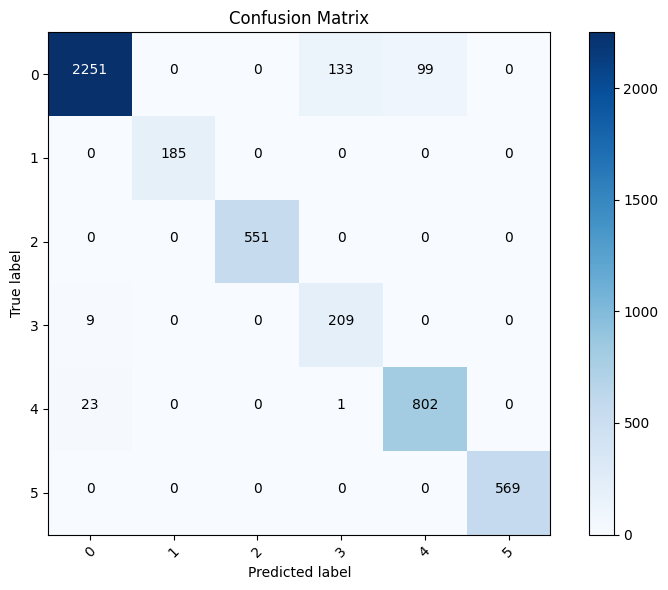

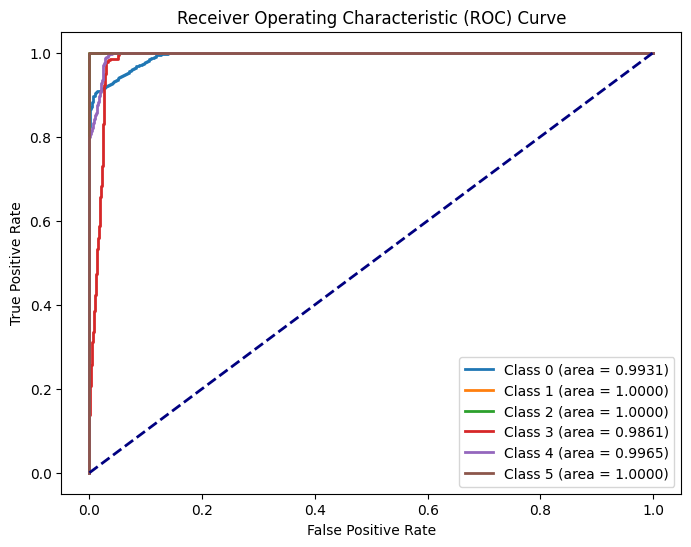

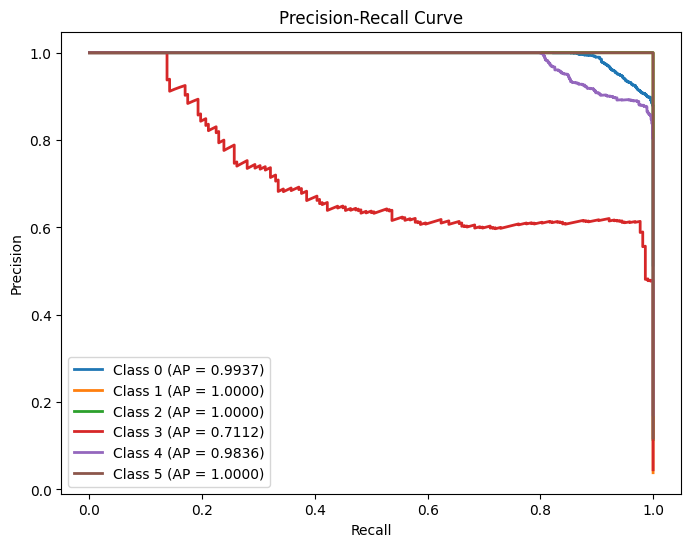

Class 0 Average Precision: 0.9937
Class 1 Average Precision: 1.0000
Class 2 Average Precision: 1.0000
Class 3 Average Precision: 0.7112
Class 4 Average Precision: 0.9836
Class 5 Average Precision: 1.0000


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, auc, precision_recall_curve, average_precision_score
from sklearn.preprocessing import label_binarize
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import roc_auc_score

voting_clf.fit(X_balanced, y_balanced)


y_test_bin = label_binarize(y_test, classes=np.unique(y_test))
y_test_prob = voting_clf.predict_proba(X_test)
auc_score = roc_auc_score(y_test_bin, y_test_prob, average='macro', multi_class='ovr')

print(f"AUC Score: {auc_score:.4f}")


cm = confusion_matrix(y_test, y_test_pred_voting)
print("\nConfusion Matrix:")
print(cm)


plt.figure(figsize=(8, 6))
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.colorbar()
tick_marks = np.arange(len(np.unique(y_test)))
plt.xticks(tick_marks, np.unique(y_test), rotation=45)
plt.yticks(tick_marks, np.unique(y_test))
plt.ylabel('True label')
plt.xlabel('Predicted label')

thresh = cm.max() / 2.
for i in range(len(np.unique(y_test))):
    for j in range(len(np.unique(y_test))):
        plt.text(j, i, format(cm[i, j], 'd'), horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

plt.tight_layout()
plt.show()


fpr = {}
tpr = {}
roc_auc = {}

for i in range(len(np.unique(y_test))):
    fpr[i], tpr[i], _ = roc_curve(y_test_bin[:, i], y_test_prob[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])


plt.figure(figsize=(8, 6))
for i in range(len(np.unique(y_test))):
    plt.plot(fpr[i], tpr[i], lw=2, label=f'Class {i} (area = {roc_auc[i]:.4f})')

plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()


precision = {}
recall = {}
average_precision = {}

for i in range(len(np.unique(y_test))):
    precision[i], recall[i], _ = precision_recall_curve(y_test_bin[:, i], y_test_prob[:, i])
    average_precision[i] = average_precision_score(y_test_bin[:, i], y_test_prob[:, i])


plt.figure(figsize=(8, 6))
for i in range(len(np.unique(y_test))):
    plt.plot(recall[i], precision[i], lw=2, label=f'Class {i} (AP = {average_precision[i]:.4f})')

plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.legend(loc="lower left")
plt.show()


for i in range(len(np.unique(y_test))):
    print(f"Class {i} Average Precision: {average_precision[i]:.4f}")


5-Fold Cross Validation Accuracy: 0.9713 ± 0.0012


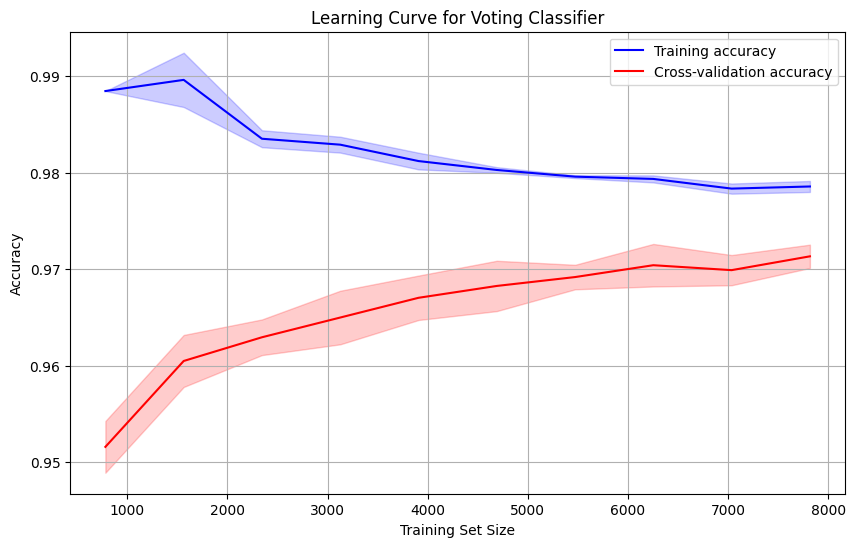

Learning Curve Calculation Time: 718.8544 seconds


In [ ]:
import time
import numpy as np
import matplotlib.pyplot as plt
from sklearn.ensemble import VotingClassifier
from sklearn.model_selection import cross_val_score, learning_curve


voting_clf = VotingClassifier(
    estimators=[('rf', classifiers['Random Forest']),
                ('dt', classifiers['Decision Tree']),
                ('et', classifiers['Extra Trees']),
                ('knn', classifiers['KNN']),
                ('mlp', classifiers['MLP']),
                ('catboost', classifiers['CatBoost']),
                ('xgboost', classifiers['XGBoost'])],
    voting='soft'
)

cv_scores = cross_val_score(voting_clf, X_balanced, y_balanced, cv=5, scoring='accuracy')


cv_accuracy_mean = np.mean(cv_scores)
cv_accuracy_std = np.std(cv_scores)

print(f"5-Fold Cross Validation Accuracy: {cv_accuracy_mean:.4f} ± {cv_accuracy_std:.4f}")


start_train_time = time.time()

train_sizes, train_scores, test_scores = learning_curve(
    voting_clf, X_balanced, y_balanced, cv=5, train_sizes=np.linspace(0.1, 1.0, 10), scoring='accuracy')

train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

end_train_time = time.time()
learning_curve_time = end_train_time - start_train_time

plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_scores_mean, label='Training accuracy', color='blue')
plt.plot(train_sizes, test_scores_mean, label='Cross-validation accuracy', color='red')
plt.fill_between(train_sizes, train_scores_mean - train_scores_std, train_scores_mean + train_scores_std, color='blue', alpha=0.2)
plt.fill_between(train_sizes, test_scores_mean - test_scores_std, test_scores_mean + test_scores_std, color='red', alpha=0.2)
plt.xlabel('Training Set Size')
plt.ylabel('Accuracy')
plt.title('Learning Curve for Voting Classifier')
plt.legend(loc='best')
plt.grid(True)
plt.show()


print(f"Learning Curve Calculation Time: {learning_curve_time:.4f} seconds")


In [ ]:
from sklearn.metrics import cohen_kappa_score

classifiers = {
    "Random Forest": RandomForestClassifier(n_estimators=100, max_depth=10, min_samples_split=4, random_state=42),
    "Decision Tree": DecisionTreeClassifier(max_depth=10, min_samples_split=4, random_state=42),
    "Extra Trees": ExtraTreesClassifier(n_estimators=100, max_depth=10, min_samples_split=4, random_state=42),
    "KNN": KNeighborsClassifier(n_neighbors=5, weights='uniform'),
    "MLP": MLPClassifier(hidden_layer_sizes=(128,), max_iter=6000, alpha=0.001, solver='adam', random_state=42),
    "CatBoost": CatBoostClassifier(iterations=500, learning_rate=0.1, depth=6, l2_leaf_reg=10, early_stopping_rounds=50, random_state=42, verbose=0),
    "XGBoost": XGBClassifier(n_estimators=100, max_depth=6, learning_rate=0.1, alpha=0.01, gamma=0, random_state=42)
}


kappa_scores = {}

for clf_name, clf in classifiers.items():
    print(f"\nTraining {clf_name}...")

    clf.fit(X_balanced, y_balanced)


    y_test_pred = clf.predict(X_test)


    kappa = cohen_kappa_score(y_test, y_test_pred)
    kappa_scores[clf_name] = kappa


    print(f"Cohen's Kappa Score for {clf_name}: {kappa:.4f}")


print("\nCohen's Kappa Scores for All Classifiers:")
for clf_name, kappa in kappa_scores.items():
    print(f"{clf_name}: {kappa:.4f}")



Training Random Forest...
Cohen's Kappa Score for Random Forest: 0.9192

Training Decision Tree...
Cohen's Kappa Score for Decision Tree: 0.9133

Training Extra Trees...
Cohen's Kappa Score for Extra Trees: 0.9021

Training KNN...
Cohen's Kappa Score for KNN: 0.8869

Training MLP...
Cohen's Kappa Score for MLP: 0.8874

Training CatBoost...
Cohen's Kappa Score for CatBoost: 0.9206

Training XGBoost...
Cohen's Kappa Score for XGBoost: 0.9184

Cohen's Kappa Scores for All Classifiers:
Random Forest: 0.9192
Decision Tree: 0.9133
Extra Trees: 0.9021
KNN: 0.8869
MLP: 0.8874
CatBoost: 0.9206
XGBoost: 0.9184


In [ ]:
from sklearn.metrics import cohen_kappa_score

start_train_time = time.time()


voting_clf.fit(X_balanced, y_balanced)


end_train_time = time.time()
train_time = end_train_time - start_train_time


y_train_pred_voting = voting_clf.predict(X_balanced)


start_test_time = time.time()


y_test_pred_voting = voting_clf.predict(X_test)

end_test_time = time.time()
test_time = end_test_time - start_test_time



kappa_voting = cohen_kappa_score(y_test, y_test_pred_voting)
print(f"\nCohen's Kappa Score for Voting Classifier on Test Data: {kappa_voting:.4f}")



Cohen's Kappa Score for Voting Classifier on Test Data: 0.9210


In [ ]:
pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 9.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=154721c09c4fc622c8d6b705e03e928122d3220a3c3d1fe5c9c0b1875ede9cea
  Stored in directory: /root/.cache/pip/wheels/85/fa/a3/9c2d44c9f3cd77cf4e533b58900b2bf4487f2a17e8ec212a3d
Successfully built lime


In [ ]:
import lime
from lime.lime_tabular import LimeTabularExplainer
import numpy as np


feature_names = ['Tn (Rated Torque) N*m', 'Ia (Amp)', 'Vab (V)', 'Speed (rad/s)']

explainer = LimeTabularExplainer(
    training_data=np.array(X_balanced),
    training_labels=np.array(y_balanced),
    mode='classification',
    class_names=np.unique(y_balanced),
    feature_names=feature_names,
    discretize_continuous=True
)


indices_to_explain = [0, 1, 2, 5, 12,22]


for idx in indices_to_explain:

    instance = X_balanced[idx].reshape(1, -1)


    explanation = explainer.explain_instance(instance[0], voting_clf.predict_proba)


    print(f"\nExplanation for instance at index {idx}:")
    explanation.show_in_notebook(show_table=True, show_all=False)


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but ExtraTreesClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but KNeighborsClassifier was fitted with feature names
  warnings.warn(



Explanation for instance at index 0:


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MLPClassifier was fitted with feature names
  warnings.warn(


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but ExtraTreesClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but KNeighborsClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MLPClassifier was fitted with feature names
  warnings.warn(



Explanation for instance at index 1:


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but ExtraTreesClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but KNeighborsClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MLPClassifier was fitted with feature names
  warnings.warn(



Explanation for instance at index 2:


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but ExtraTreesClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but KNeighborsClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MLPClassifier was fitted with feature names
  warnings.warn(



Explanation for instance at index 5:


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but ExtraTreesClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but KNeighborsClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MLPClassifier was fitted with feature names
  warnings.warn(



Explanation for instance at index 12:


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but ExtraTreesClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but KNeighborsClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MLPClassifier was fitted with feature names
  warnings.warn(



Explanation for instance at index 22:


In [ ]:
train_df_balanced

,Tn (Rated Torque) N*m,k (constant of proportionality),Ia (Amp),Ib (Amp),Vab (V),Torque (N*m),Speed (rad/s),Category
26541,1.918865,1.917888,0.012263,0.265821,0.210086,1.386625,-0.108680,1
8588,-1.248609,-1.243596,-0.959479,-0.740333,0.203891,0.065967,0.744111,0
54174,-1.248609,-1.243596,-0.773687,-0.546564,-1.056057,-0.478351,0.250825,5
55044,-1.248609,-1.243596,-0.774002,-0.546401,-1.056057,-0.214798,0.258211,5
53438,-1.022361,-1.018048,-0.407411,-0.195402,-1.698887,-0.272729,-0.332754,5
...,...,...,...,...,...,...,...,...
6993,0.335128,0.336384,2.284746,1.863755,0.203518,-1.183694,0.269822,0
31565,-0.343617,-0.341023,-0.804367,-0.578533,1.193682,-0.037616,0.775238,2
22750,1.918865,1.917888,0.017401,0.278350,0.210084,1.375589,-0.121157,1
5872,-0.004244,-0.002319,-0.577327,-0.341787,0.210185,0.157414,0.402062,0


Error: Runtime no longer has a reference to this dataframe, please re-run this cell and try again.


In [ ]:
import lime
from lime.lime_tabular import LimeTabularExplainer
import numpy as np
import matplotlib.pyplot as plt


feature_names = ['Tn (Rated Torque) N*m', 'Ia (Amp)', 'Vab (V)', 'Speed (rad/s)']


explainer = LimeTabularExplainer(
    training_data=np.array(X_balanced),
    training_labels=np.array(y_balanced),
    mode='classification',
    class_names=np.unique(y_balanced),
    feature_names=feature_names,
    discretize_continuous=True
)


indices_to_explain = [0, 1, 2, 5, 12, 22]


for idx in indices_to_explain:

    if isinstance(X_balanced, pd.DataFrame):
        instance = X_balanced.iloc[idx].values.reshape(1, -1)
    else:
        instance = X_balanced[idx].reshape(1, -1)


    explanation = explainer.explain_instance(instance[0], voting_clf.predict_proba)


    print(f"\nExplanation for instance at index {idx}:")


    plt.figure(figsize=(10, 14))
    explanation.show_in_notebook(show_table=True, show_all=False)
    plt.show()


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but ExtraTreesClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but KNeighborsClassifier was fitted with feature names
  warnings.warn(



Explanation for instance at index 0:


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MLPClassifier was fitted with feature names
  warnings.warn(


<Figure size 1000x1400 with 0 Axes>

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but ExtraTreesClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but KNeighborsClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MLPClassifier was fitted with feature names
  warnings.warn(



Explanation for instance at index 1:


<Figure size 1000x1400 with 0 Axes>

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but ExtraTreesClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but KNeighborsClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MLPClassifier was fitted with feature names
  warnings.warn(



Explanation for instance at index 2:


<Figure size 1000x1400 with 0 Axes>

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but ExtraTreesClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but KNeighborsClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MLPClassifier was fitted with feature names
  warnings.warn(



Explanation for instance at index 5:


<Figure size 1000x1400 with 0 Axes>

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but ExtraTreesClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but KNeighborsClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MLPClassifier was fitted with feature names
  warnings.warn(



Explanation for instance at index 12:


<Figure size 1000x1400 with 0 Axes>

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but ExtraTreesClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but KNeighborsClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MLPClassifier was fitted with feature names
  warnings.warn(



Explanation for instance at index 22:


<Figure size 1000x1400 with 0 Axes>